#**WIX3001 - Alternative Assessment**

## Group Members:
1.   OON YEE SEM     &nbsp;&nbsp;&nbsp;&nbsp;&nbsp;S2143263
2.   KONG YAN HAO    &nbsp;&nbsp;S2178056
3.   LOW HUI YI      &nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp; 22004790
4.   TAN JIN KHYE    &nbsp;&nbsp;&nbsp;&nbsp;22004758
5.   TAN YAN HO      &nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;22056796  


# **Imports**

In [ ]:
pip install scikit-fuzzy

In [ ]:
import numpy as np
import pandas as pd
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
import os
import cv2
import tensorflow as tf
from tqdm import tqdm
from tensorflow.keras.utils import plot_model
import tensorflow.keras.backend as K
import seaborn as sns
import skfuzzy as fuzz
from skfuzzy import control as ctrl
from sklearn.metrics import confusion_matrix,classification_report

# **Distributed Training**

In [ ]:
# Detect hardware
try:
  # TPU Detector
  tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
except ValueError:
  tpu = None
  gpus = tf.config.experimental.list_logical_devices("GPU")

# Select appropriate distribution strategy
if tpu:
  tf.config.experimental_connect_to_cluster(tpu)
  tf.tpu.experimental.initialize_tpu_system(tpu)
  strategy = tf.distribute.experimental.TPUStrategy(tpu)
  print("Running on TPU ")
elif len(gpus) > 1:
  strategy = tf.distribute.MirroredStrategy([gpu.name for gpu in gpus])
  print("Running on multiple GPUs ",[gpu.name for gpu in gpus])
elif len(gpus) == 1:
  # strategy for single-machine execution
  strategy = tf.distribute.get_strategy()
  print("Running on single GPU ",gpus[0].name)
else:
  # strategy for single-machine execution
  strategy = tf.distribute.get_strategy()
  print("Running on single CPU ")

print("Number of accelerators ",strategy.num_replicas_in_sync)

Running on single GPU  /device:GPU:0
Number of accelerators  1


# **Dataset Loading and Preprocessing**

In [ ]:
!git clone https://github.com/Walmond3/WIX3001-Alt-Ass

fatal: destination path 'WIX3001-Alt-Ass' already exists and is not an empty directory.


**Image Preprocessing with Fuzzy Logic**

In [ ]:
# Function to print rules in IF-THEN format
def print_rules(rules):
    print("Fuzzy rules:")
    for rule in rules:
        antecedent = rule.antecedent
        consequent = rule.consequent
        print(f"If {antecedent} THEN {consequent}")
    print("\n")

In [ ]:
# Fuzzy logic 1 set up
def setup_fuzzy_logic_1():
    # Define fuzzy variables
    brightness = ctrl.Antecedent(np.arange(0, 256, 1), 'brightness')
    sharpness_lv = ctrl.Antecedent(np.arange(0, 128, 1), 'sharpness')
    contrast = ctrl.Consequent(np.arange(0, 256, 1), 'contrast')

    # Define membership functions
    brightness['low'] = fuzz.trimf(brightness.universe, [0, 0, 128])
    brightness['medium'] = fuzz.trimf(brightness.universe, [0, 128, 255])
    brightness['high'] = fuzz.trimf(brightness.universe, [128, 255, 255])

    sharpness_lv['low'] = fuzz.trimf(sharpness_lv.universe, [0, 0, 64])
    sharpness_lv['medium'] = fuzz.trimf(sharpness_lv.universe, [0, 64, 128])
    sharpness_lv['high'] = fuzz.trimf(sharpness_lv.universe, [64, 128, 128])

    contrast['low'] = fuzz.trimf(contrast.universe, [0, 0, 128])
    contrast['medium'] = fuzz.trimf(contrast.universe, [0, 128, 255])
    contrast['high'] = fuzz.trimf(contrast.universe, [128, 255, 255])

    # Plot membership functions
    brightness.view()
    sharpness_lv.view()
    contrast.view()
    plt.show()

    print("\n")

    # Define fuzzy rules
    rules = [
        ctrl.Rule(brightness['low'] & sharpness_lv['low'], contrast['high']),
        ctrl.Rule(brightness['medium'] & sharpness_lv['medium'], contrast['medium']),
        ctrl.Rule(brightness['high'] & sharpness_lv['high'], contrast['low']),
        ctrl.Rule(brightness['low'] & sharpness_lv['high'], contrast['medium']),
        ctrl.Rule(brightness['high'] & sharpness_lv['low'], contrast['medium'])
    ]

    # Print the rules in IF-THEN format
    print_rules(rules)

    return ctrl.ControlSystem(rules)

# Apply fuzzy logic 1
def apply_fuzzy_logic_1(image, contrast_ctrl):
    # Convert image to grayscale
    gray_img = ImageOps.grayscale(image)
    np_gray_img = np.array(gray_img)

    # Calculate mean brightness and standard deviation for sharpness
    mean_brightness = np.mean(np_gray_img)
    sharpness = np.std(np_gray_img)

    contrast_sim = ctrl.ControlSystemSimulation(contrast_ctrl)

    # Input values into the fuzzy system
    contrast_sim.input['brightness'] = mean_brightness
    contrast_sim.input['sharpness'] = sharpness

    contrast_sim.compute()
    contrast_value = contrast_sim.output['contrast']

    # Apply contrast adjustment
    adjusted_img = ImageOps.autocontrast(image, cutoff=contrast_value)

    return adjusted_img

In [ ]:
# Necessary calculation to use in fuzzy logic 2
def calculate_edge_density(image):
    # Convert image to grayscale
    gray_img = ImageOps.grayscale(image)
    np_gray_img = np.array(gray_img)
    # Calculate edges using Sobel filter
    sobel_x = np.abs(np.gradient(np_gray_img, axis=0))
    sobel_y = np.abs(np.gradient(np_gray_img, axis=1))
    edges = np.hypot(sobel_x, sobel_y)
    # Normalize edges and calculate edge density
    edge_density = np.mean(edges) / 255.0
    return edge_density

def calculate_texture_complexity(image):
    # Convert image to grayscale
    gray_img = ImageOps.grayscale(image)
    np_gray_img = np.array(gray_img)
    # Calculate texture complexity using variance of Laplacian
    laplacian = np.var(np.gradient(np_gray_img))
    return laplacian

In [ ]:
# Fuzzy logic 2 set up
def setup_fuzzy_logic_2():
    # Define fuzzy variables
    brightness = ctrl.Antecedent(np.arange(0, 256, 1), 'brightness')
    sharpness_lv = ctrl.Antecedent(np.arange(0, 128, 1), 'sharpness')
    saturation = ctrl.Antecedent(np.arange(0, 256, 1), 'saturation')
    hue = ctrl.Antecedent(np.arange(0, 256, 1), 'hue')
    edge_density_lv = ctrl.Antecedent(np.arange(0, 1, 0.01), 'edge_density')
    texture_complexity_lv = ctrl.Antecedent(np.arange(0, 2560, 1), 'texture_complexity')
    contrast = ctrl.Consequent(np.arange(0, 256, 1), 'contrast')

    # Define fuzzy membership functions
    brightness['low'] = fuzz.trimf(brightness.universe, [0, 0, 128])
    brightness['medium'] = fuzz.trimf(brightness.universe, [0, 128, 255])
    brightness['high'] = fuzz.trimf(brightness.universe, [128, 255, 255])

    sharpness_lv['low'] = fuzz.trimf(sharpness_lv.universe, [0, 0, 64])
    sharpness_lv['medium'] = fuzz.trimf(sharpness_lv.universe, [0, 64, 128])
    sharpness_lv['high'] = fuzz.trimf(sharpness_lv.universe, [64, 128, 128])

    saturation['low'] = fuzz.trimf(saturation.universe, [0, 0, 128])
    saturation['medium'] = fuzz.trimf(saturation.universe, [0, 128, 255])
    saturation['high'] = fuzz.trimf(saturation.universe, [128, 255, 255])

    hue['low'] = fuzz.trimf(hue.universe, [0, 0, 128])
    hue['medium'] = fuzz.trimf(hue.universe, [0, 128, 255])
    hue['high'] = fuzz.trimf(hue.universe, [128, 255, 255])

    edge_density_lv['low'] = fuzz.trimf(edge_density_lv.universe, [0, 0, 0.5])
    edge_density_lv['medium'] = fuzz.trimf(edge_density_lv.universe, [0, 0.5, 1])
    edge_density_lv['high'] = fuzz.trimf(edge_density_lv.universe, [0.5, 1, 1])

    texture_complexity_lv['low'] = fuzz.trimf(texture_complexity_lv.universe, [0, 0, 1280])
    texture_complexity_lv['medium'] = fuzz.trimf(texture_complexity_lv.universe, [0, 1280, 2560])
    texture_complexity_lv['high'] = fuzz.trimf(texture_complexity_lv.universe, [1280, 2560, 2560])

    contrast['low'] = fuzz.trimf(contrast.universe, [0, 0, 128])
    contrast['medium'] = fuzz.trimf(contrast.universe, [0, 128, 255])
    contrast['high'] = fuzz.trimf(contrast.universe, [128, 255, 255])

    # Plot membership functions
    brightness.view()
    sharpness_lv.view()
    saturation.view()
    hue.view()
    edge_density_lv.view()
    texture_complexity_lv.view()
    contrast.view()
    plt.show()

    print("\n")

    # Define fuzzy rules
    rules = [
        ctrl.Rule(brightness['low'] & sharpness_lv['low'] & saturation['low'], contrast['high']),
        ctrl.Rule(brightness['medium'] & sharpness_lv['medium'] & saturation['medium'], contrast['medium']),
        ctrl.Rule(brightness['high'] & sharpness_lv['high'] & saturation['high'], contrast['low']),
        ctrl.Rule(brightness['low'] & sharpness_lv['high'] & saturation['high'], contrast['medium']),
        ctrl.Rule(brightness['high'] & sharpness_lv['low'] & saturation['low'], contrast['medium']),
        ctrl.Rule(hue['low'] & edge_density_lv['low'] & texture_complexity_lv['low'], contrast['high']),
        ctrl.Rule(hue['medium'] & edge_density_lv['medium'] & texture_complexity_lv['medium'], contrast['medium']),
        ctrl.Rule(hue['high'] & edge_density_lv['high'] & texture_complexity_lv['high'], contrast['low']),
        ctrl.Rule(hue['low'] & edge_density_lv['high'] & texture_complexity_lv['high'], contrast['medium']),
        ctrl.Rule(hue['high'] & edge_density_lv['low'] & texture_complexity_lv['low'], contrast['medium']),
        ctrl.Rule(brightness['low'] & sharpness_lv['low'], contrast['high']),
        ctrl.Rule(brightness['high'] & sharpness_lv['high'], contrast['low']),
        ctrl.Rule(edge_density_lv['low'] & texture_complexity_lv['low'], contrast['high']),
        ctrl.Rule(edge_density_lv['high'] & texture_complexity_lv['high'], contrast['low'])
    ]

    # Print the rules in IF-THEN format
    print_rules(rules)

    return ctrl.ControlSystem(rules)

# Apply fuzzy logic 2
def apply_fuzzy_logic_2(image, contrast_ctrl):
    # Convert image to grayscale
    gray_img = ImageOps.grayscale(image)
    np_gray_img = np.array(gray_img)
    np_rgb_img = np.array(image)

    # Calculate mean brightness and standard deviation for sharpness
    mean_brightness = np.mean(np_gray_img)
    sharpness = np.std(np_gray_img)
    hsv_img = image.convert('HSV')
    np_hsv_img = np.array(hsv_img)
    mean_saturation = np.mean(np_hsv_img[:, :, 1])
    mean_hue = np.mean(np_hsv_img[:, :, 0])
    edge_density = calculate_edge_density(image)
    texture_complexity = calculate_texture_complexity(image)

    contrast_sim = ctrl.ControlSystemSimulation(contrast_ctrl)

    # Input values into the fuzzy system
    contrast_sim.input['brightness'] = mean_brightness
    contrast_sim.input['sharpness'] = sharpness
    contrast_sim.input['saturation'] = mean_saturation
    contrast_sim.input['hue'] = mean_hue
    contrast_sim.input['edge_density'] = edge_density
    contrast_sim.input['texture_complexity'] = texture_complexity

    contrast_sim.compute()
    contrast_value = contrast_sim.output['contrast']

    # Apply contrast adjustment
    adjusted_img = ImageOps.autocontrast(image, cutoff=contrast_value)

    return adjusted_img

In [ ]:
# Function to choose which fuzzy logic system to apply
def preprocess_image_with_fuzzy_logic(image, contrast_ctrl, fuzzy_system='fuzzy1'):
    if fuzzy_system == 'fuzzy1':
        return apply_fuzzy_logic_1(image, contrast_ctrl)
    elif fuzzy_system == 'fuzzy2':
        return apply_fuzzy_logic_2(image, contrast_ctrl)
    else:
        raise ValueError("Invalid fuzzy logic system specified.")

**Image Cropping**

Set Up For Fuzzy Logic System 2:


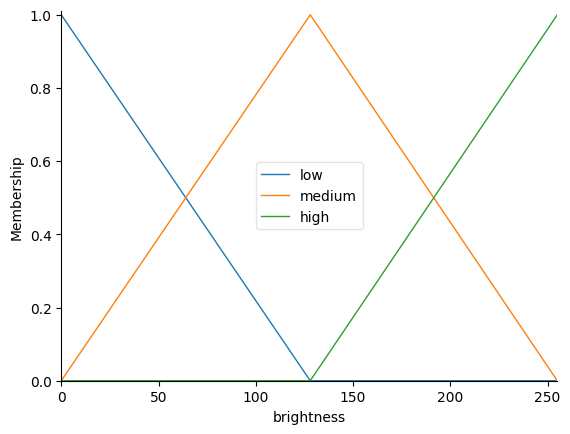

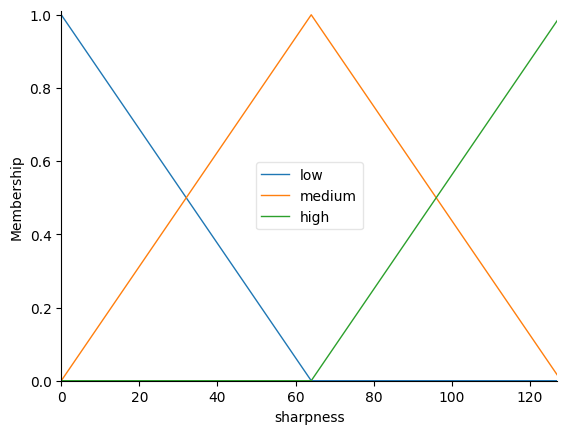

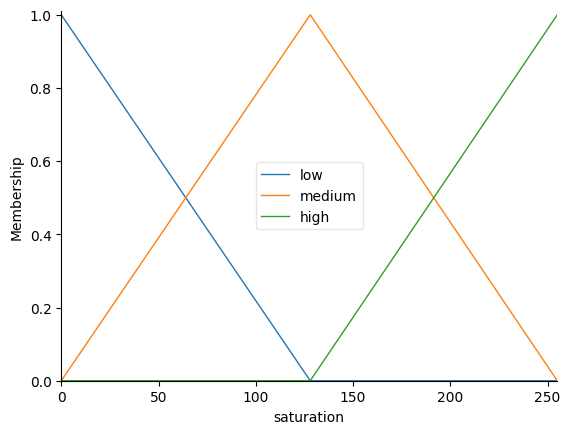

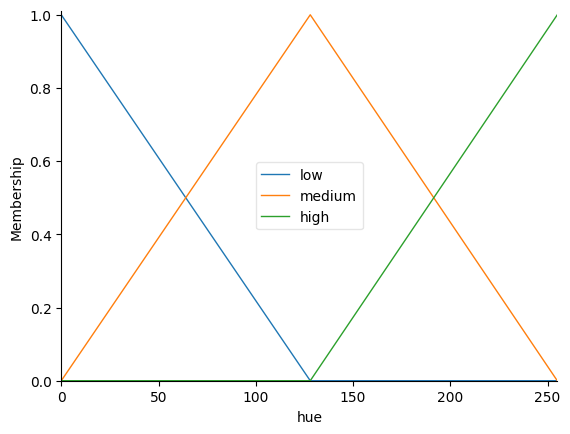

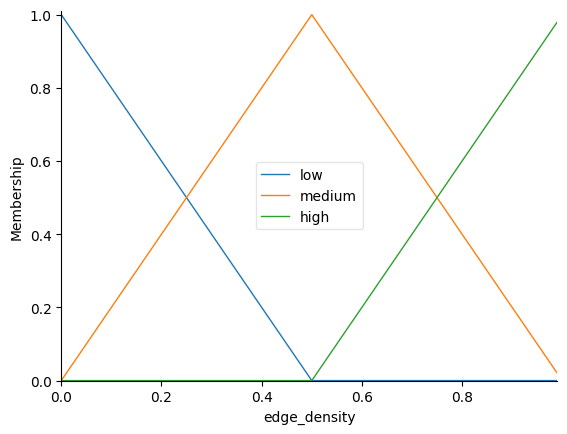

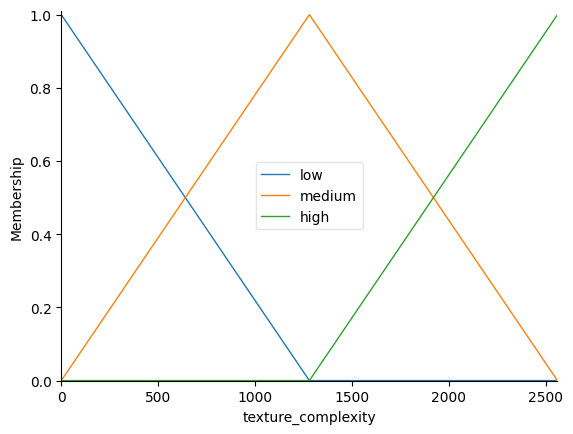

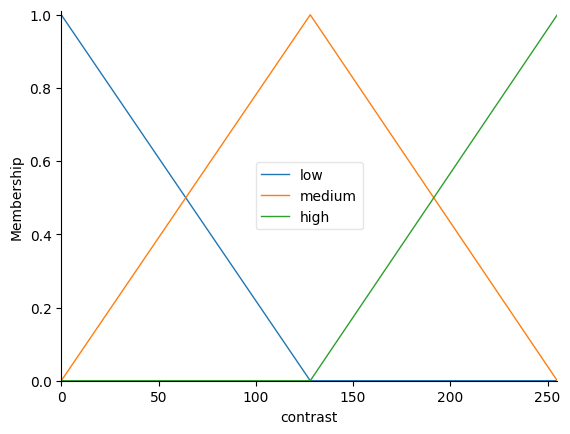



Fuzzy rules:
If (brightness[low] AND sharpness[low]) AND saturation[low] THEN [contrast[high]]
If (brightness[medium] AND sharpness[medium]) AND saturation[medium] THEN [contrast[medium]]
If (brightness[high] AND sharpness[high]) AND saturation[high] THEN [contrast[low]]
If (brightness[low] AND sharpness[high]) AND saturation[high] THEN [contrast[medium]]
If (brightness[high] AND sharpness[low]) AND saturation[low] THEN [contrast[medium]]
If (hue[low] AND edge_density[low]) AND texture_complexity[low] THEN [contrast[high]]
If (hue[medium] AND edge_density[medium]) AND texture_complexity[medium] THEN [contrast[medium]]
If (hue[high] AND edge_density[high]) AND texture_complexity[high] THEN [contrast[low]]
If (hue[low] AND edge_density[high]) AND texture_complexity[high] THEN [contrast[medium]]
If (hue[high] AND edge_density[low]) AND texture_complexity[low] THEN [contrast[medium]]
If brightness[low] AND sharpness[low] THEN [contrast[high]]
If brightness[high] AND sharpness[high] THEN 

In [ ]:
def crop_image_into_pieces(image_path, output_folder, rows, columns, owner, contrast_ctrl, fuzzy_system='fuzzy1'):
    # Open the image
    image = Image.open(image_path)

    # Convert image to RGB mode (remove alpha channel)
    image = image.convert("RGB")

    # Get the dimensions of the original image
    original_width, original_height = image.size

    # Calculate the width and height of each piece
    piece_width = original_width // columns
    piece_height = original_height // rows

    # Initialize a list to store data for each cropped image
    cropped_images_data = []

    # Iterate through each row and column
    for row in range(rows):
        for col in range(columns):
            # Calculate the coordinates for cropping
            left = col * piece_width
            upper = row * piece_height
            right = left + piece_width
            lower = upper + piece_height

            # Crop the image
            cropped_img = image.crop((left, upper, right, lower))

            # Process the image
            processed_img = preprocess_image_with_fuzzy_logic(cropped_img, contrast_ctrl, fuzzy_system=fuzzy_system)

            # Invert the colors
            processed_img = ImageOps.invert(cropped_img)

            # Create output subfolder if it doesn't exist
            os.makedirs(output_folder, exist_ok=True)

            # Save the cropped image
            output_filename = f"{owner}_crop_{row}_{col}.jpg"
            output_filepath = os.path.join(output_folder, output_filename)
            processed_img.save(output_filepath)
            cropped_images_data.append({
                "Filename": output_filename,
                "Filepath": output_filepath,
                "Owner": owner
            })

    print(f"All crops for {owner} saved!")
    return cropped_images_data

# Directory where the images are stored
images_directory = "/content/WIX3001-Alt-Ass/Handwriting"

# Output folder to save cropped images within Colab
output_folder = "/content/output_crops"

# Number of rows and columns in the grid
rows = 12
columns = 12

# Check if the images directory exists
if not os.path.exists(images_directory):
    print(f"Error: {images_directory} does not exist.")
    exit()

# List all files in the images directory
image_files = os.listdir(images_directory)

# Check if there are any image files
if not image_files:
    print(f"No image files found in {images_directory}.")
    exit()

# Setup the fuzzy logic system
print("Set Up For Fuzzy Logic System 2:")
contrast_ctrl = setup_fuzzy_logic_2()

# Initialize a list to store all cropped images data
all_cropped_images_data = []

# Iterate through each image file
for image_file in image_files:
    image_path = os.path.join(images_directory, image_file)
    owner, _ = os.path.splitext(image_file)  # Get owner from filename without extension
    cropped_images_data = crop_image_into_pieces(image_path, output_folder, rows, columns, owner, contrast_ctrl, fuzzy_system='fuzzy2')

    # Testing
    all_cropped_images_data.extend(cropped_images_data)

In [ ]:
# Check whether all images are in same size
def check_equal_dimensions(directory):
    first_image = None
    equal_dimensions = True

    for filename in os.listdir(directory):
        if filename.endswith(".jpg"):
            # Load the image
            image = cv2.imread(os.path.join(directory, filename), cv2.IMREAD_GRAYSCALE)

            if image is None:
                print("Error loading image:", filename)
                continue  # Skip to the next image

            # Get the dimensions (height and width) of the image
            height, width = image.shape[:2]  # [:2] for height and width

            if first_image is None:
                # Save dimensions of the first image encountered
                first_image = (height, width)
            else:
                # Compare dimensions with the first image
                if (height, width) != first_image:
                    equal_dimensions = False
                    break  # Stop checking, as we've found a different dimension

    return equal_dimensions

result = check_equal_dimensions(output_folder)

if result:
    print("All images have equal height and width.")
else:
    print("Images have varying height and width.")


All images have equal height and width.


**Store Data in DataFrame**

In [ ]:
# Create a DataFrame from the list of cropped images data
df = pd.DataFrame(all_cropped_images_data)
df.head()

,Filename,Filepath,Owner
0,Yan Hao_crop_0_0.jpg,/content/output_crops/Yan Hao_crop_0_0.jpg,Yan Hao
1,Yan Hao_crop_0_1.jpg,/content/output_crops/Yan Hao_crop_0_1.jpg,Yan Hao
2,Yan Hao_crop_0_2.jpg,/content/output_crops/Yan Hao_crop_0_2.jpg,Yan Hao
3,Yan Hao_crop_0_3.jpg,/content/output_crops/Yan Hao_crop_0_3.jpg,Yan Hao
4,Yan Hao_crop_0_4.jpg,/content/output_crops/Yan Hao_crop_0_4.jpg,Yan Hao


In [ ]:
sem_df = df[df["Owner"] == "Yee Sem"]
ho_df = df[df["Owner"] == "Yan Ho"]
hao_df = df[df["Owner"] == "Yan Hao"]
hui_df = df[df["Owner"] == "Hui Yi"]
jin_df = df[df["Owner"] == "Jin Khye"]

image_path = []
for i in range(0,len(sem_df),4):
  for j in range(4):
    image_path.append(sem_df["Filepath"].iloc[i+j])
  for j in range(4):
    image_path.append(hui_df["Filepath"].iloc[i+j])
  for j in range(4):
    image_path.append(hao_df["Filepath"].iloc[i+j])
  for j in range(4):
    image_path.append(jin_df["Filepath"].iloc[i+j])
  for j in range(4):
    image_path.append(ho_df["Filepath"].iloc[i+j])

**Display Images**

In [ ]:
def display_images(filepaths, title):
    fig, axes = plt.subplots(len(filepaths) // columns, columns, figsize=(10, 10))
    fig.suptitle(title)
    for i, filepath in enumerate(filepaths):
        img = Image.open(filepath)
        ax = axes[i // columns, i % columns]
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

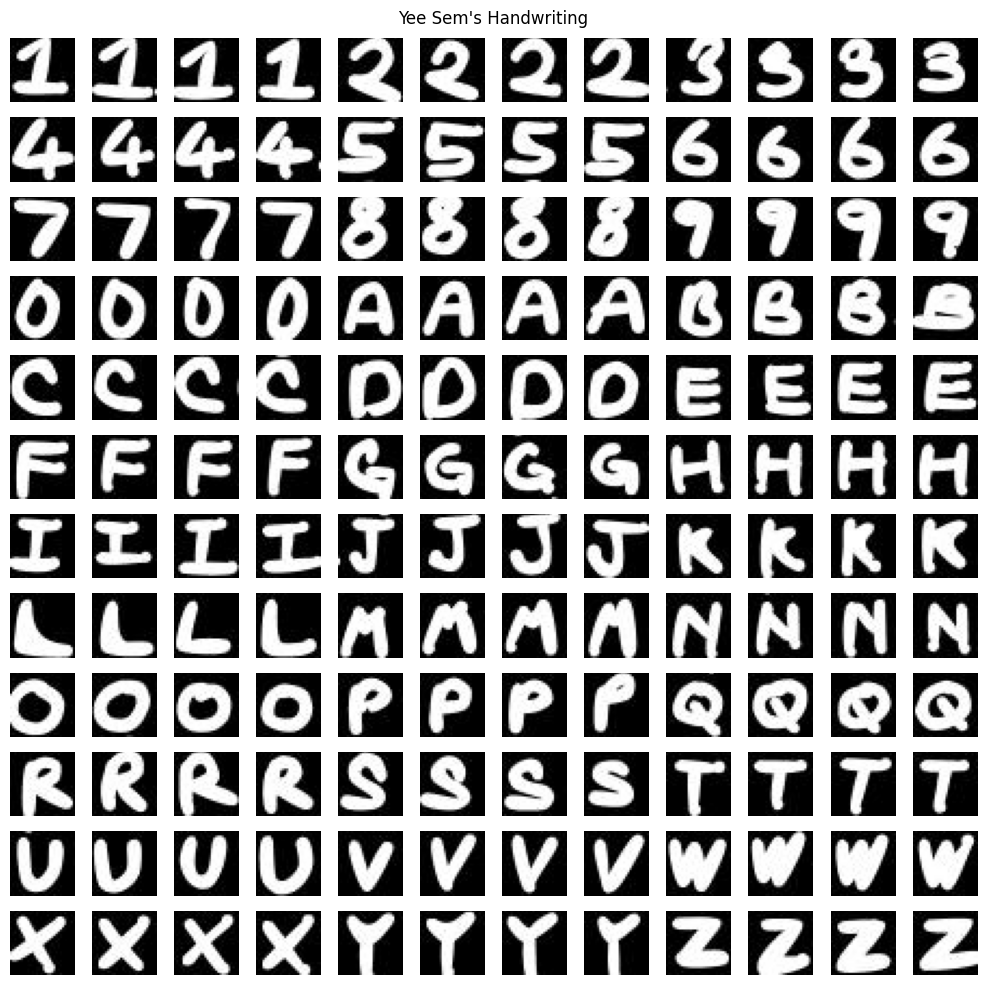

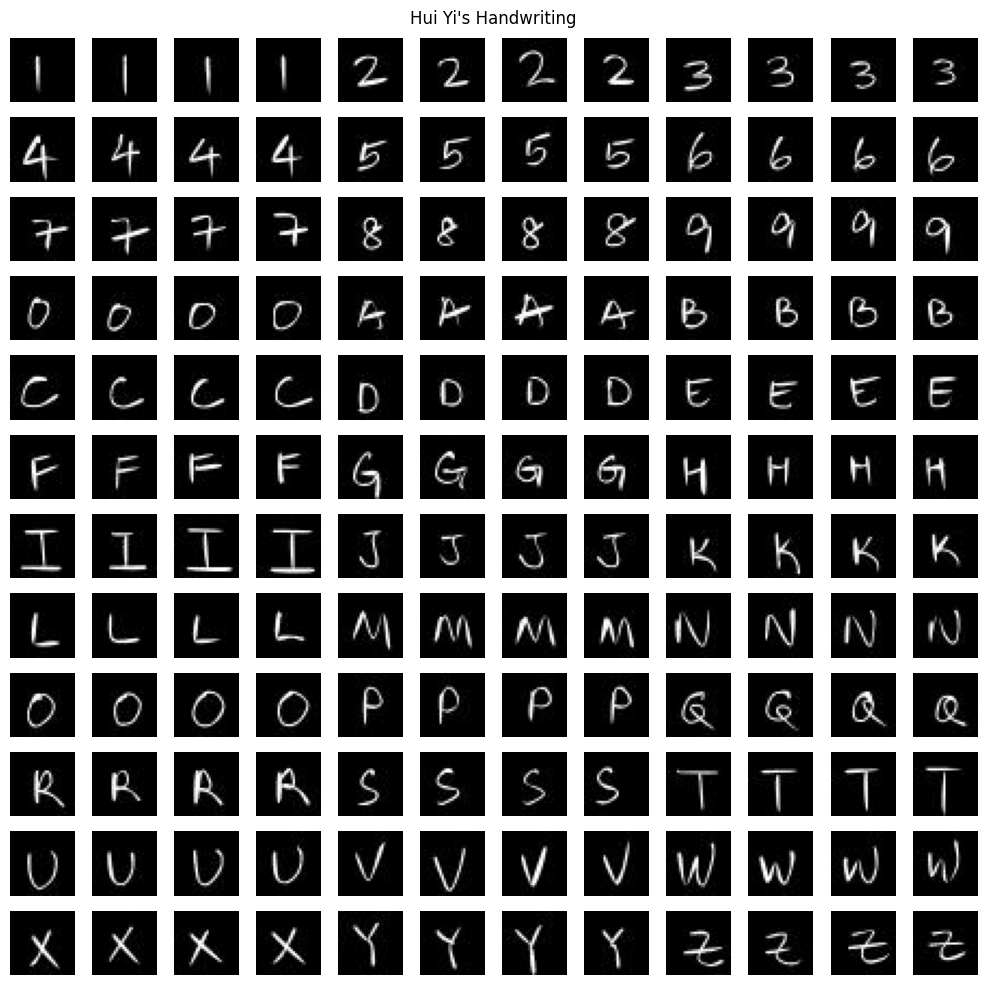

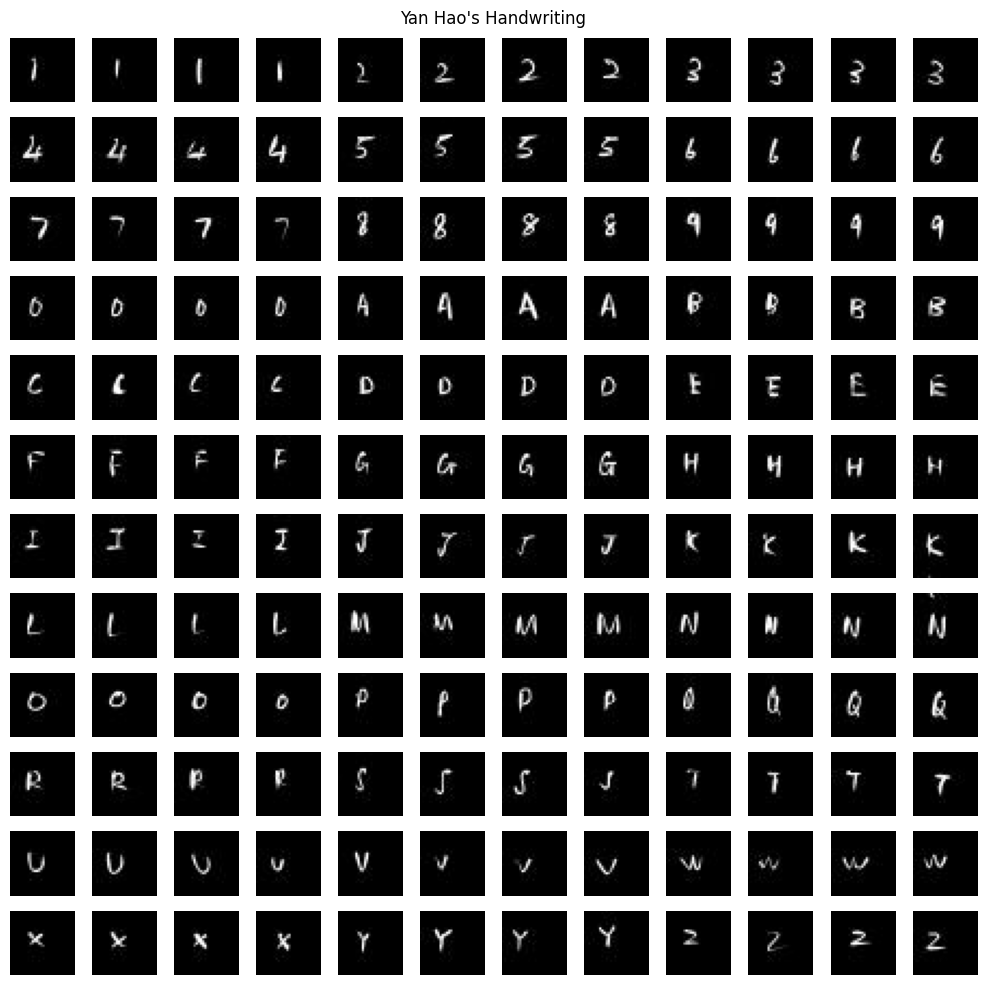

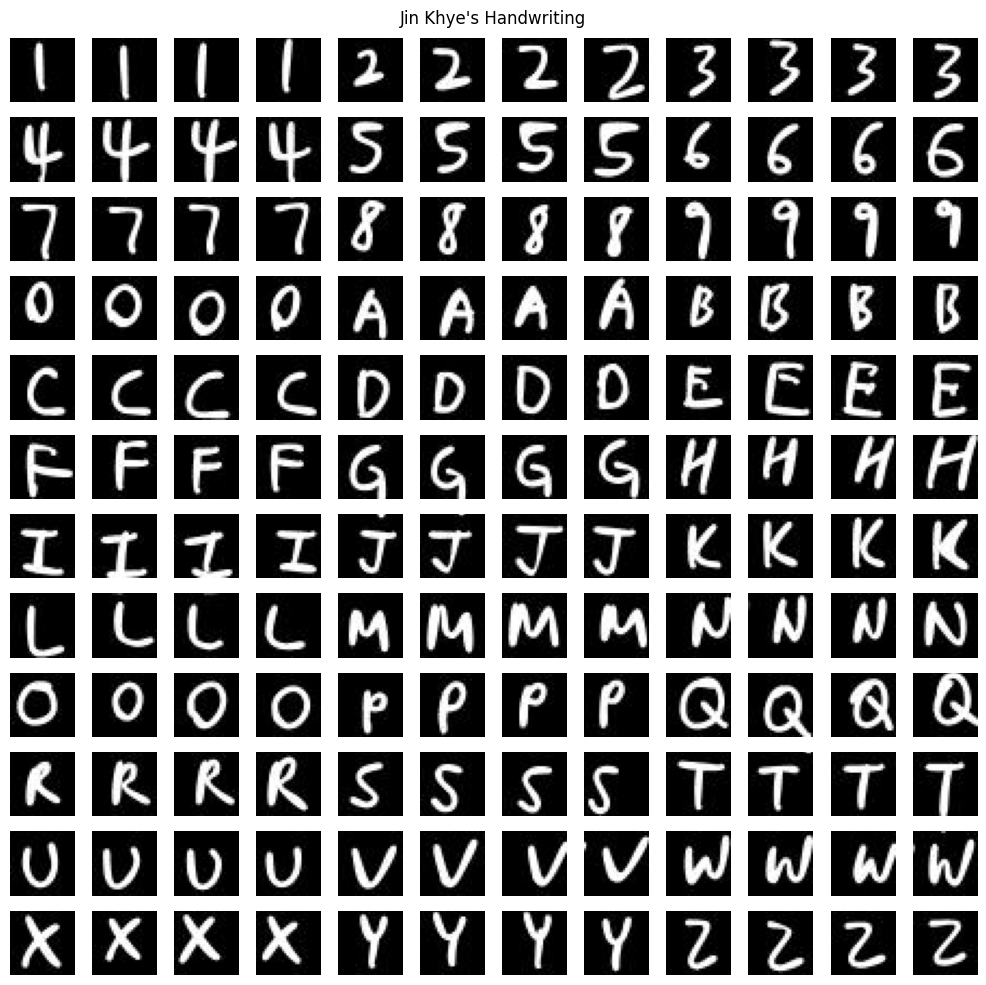

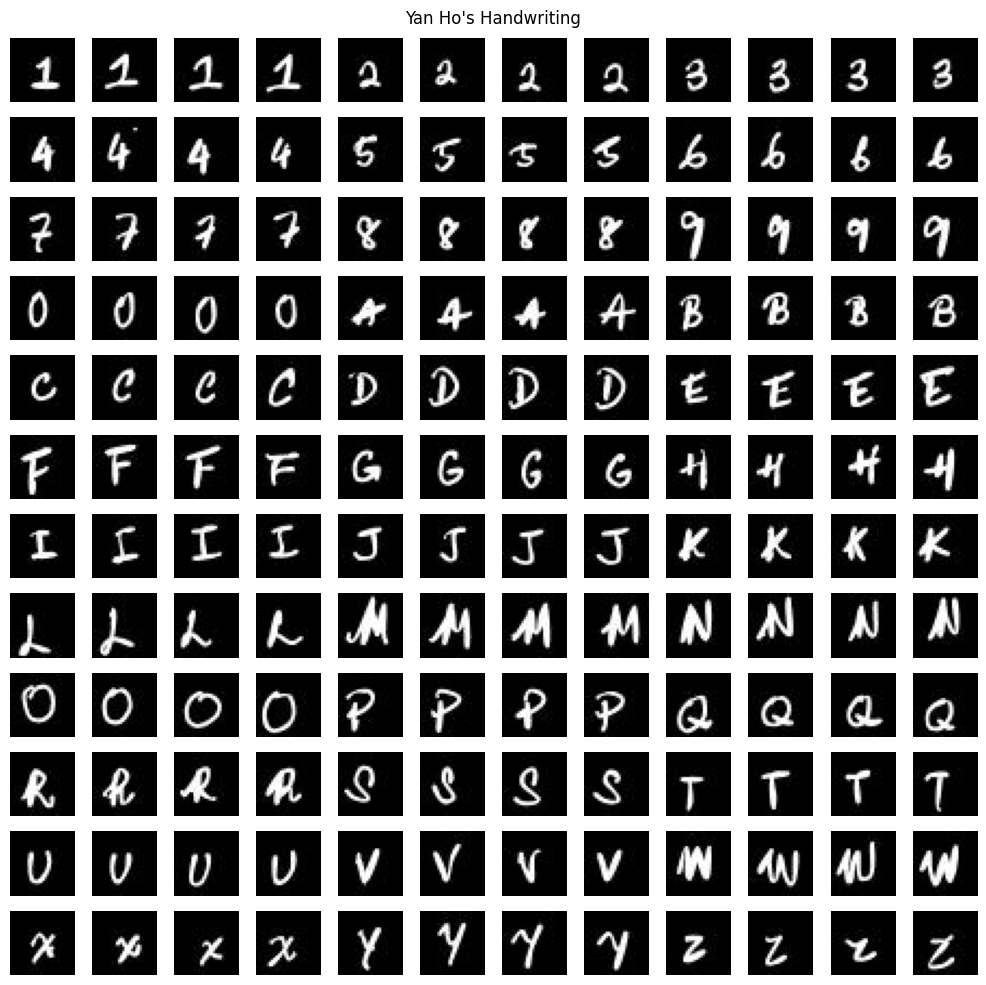

In [ ]:
# Display dataset
owners = ["Yee Sem",'Hui Yi','Yan Hao','Jin Khye','Yan Ho']
for owner in owners:
  display_images(df['Filepath'][df["Owner"] == owner],f"{owner}'s Handwriting")
  print()

#**Feature Extraction**

In [ ]:
# For feature extraction
from skimage.feature import hog
from skimage import exposure
from skimage.feature import local_binary_pattern
from skimage.color import rgb2gray
from scipy.stats import skew, kurtosis
from scipy.ndimage import variance

import numpy as np
from sklearn.preprocessing import MinMaxScaler, LabelEncoder

**Functions for Calculations**

In [ ]:
def load_image(filename):
    image = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    return image

In [ ]:
def preprocess_image(image):
    # Convert to binary image
    _, binary = cv2.threshold(image, 128, 255, cv2.THRESH_BINARY)

    # Apply Gaussian blur for noise removal
    binary = cv2.GaussianBlur(binary, (5, 5), 0)

    return binary

In [ ]:
# Compute Histograms of Pixel Intensity
def compute_histogram(image):
    hist, _ = np.histogram(image.flatten(), bins=256, range=[0, 256])
    return hist

In [ ]:
# Compute HOG (Histogram of Oriented Gradients) Features
def compute_hog(image):
    fd, _ = hog(image, orientations=8, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True)

    return fd.ravel()

In [ ]:
# Compute Hu Moments
def compute_hu_moments(image):
    moments = cv2.moments(image)
    hu_moments = cv2.HuMoments(moments).flatten()
    return hu_moments

In [ ]:
# Compute Local Binary Patterns (LBP)
def compute_lbp(image):
    lbp = local_binary_pattern(image, 8, 1, method='default')
    lbp_hist, _ = np.histogram(lbp.ravel(), bins=np.arange(0, 12), range=(0, 11))
    lbp_hist = lbp_hist.astype("float")
    lbp_hist /= (lbp_hist.sum() + 1e-7)
    return lbp_hist

In [ ]:
# Compute additional statistical features
def compute_additional_features(image):
    mean_value = np.mean(image)
    std_dev = np.std(image)
    var = variance(image)
    skewness = skew(image.flatten())
    kurt = kurtosis(image.flatten())
    return [mean_value, std_dev, var, skewness, kurt]

In [ ]:
# Stroke direction and curvature
def compute_stroke_direction_and_curvature(image):
    # Apply Canny edge detection
    edges = cv2.Canny(image, 100, 200)

    # Compute gradient magnitude and direction using Sobel operator
    grad_x = cv2.Sobel(edges, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(edges, cv2.CV_64F, 0, 1, ksize=3)
    gradient_magnitude = np.sqrt(grad_x**2 + grad_y**2)
    gradient_direction = np.arctan2(grad_y, grad_x) * 180 / np.pi

    # Compute orientation histogram
    orientation_histogram, _ = np.histogram(gradient_direction, bins=9, range=(0, 180))

    # Analyze curvature to extract curvature features
    dx = cv2.Sobel(edges, cv2.CV_64F, 1, 0, ksize=3)
    dy = cv2.Sobel(edges, cv2.CV_64F, 0, 1, ksize=3)
    dxx = cv2.Sobel(dx, cv2.CV_64F, 1, 0, ksize=3)
    dyy = cv2.Sobel(dy, cv2.CV_64F, 0, 1, ksize=3)
    dxy = cv2.Sobel(dx, cv2.CV_64F, 0, 1, ksize=3)
    curvature = (dxx * dyy - dxy ** 2) / ((1 + dx ** 2) ** 1.5)
    mean_curvature = np.mean(curvature)

    return [gradient_magnitude, gradient_direction, orientation_histogram, mean_curvature]

In [ ]:
# Letter formation
def compute_letter_formation(image):
    # Segment characters from the background using thresholding
    _, binary = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Find contours of characters
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    return contours

**Store Calculations in DataFrame**

In [ ]:
# Create an empty list to store values
histograms = []
hog_features_list = []
hu_moments_list = []
lbp_features_list = []
mean_values = []
std_devs = []
vars_list = []
skewness_list = []
kurtosis_list = []
gradient_magnitude = []
gradient_direction = []
orientation_histogram = []
mean_curvature = []
contours_list = []

# Iterate through each row in the DataFrame
for index, row in df.iterrows():
    filepath = row['Filepath']

    # Load the image
    image = load_image(filepath)

    # Check if image is loaded successfully
    if image is not None:

        # Preprocess the image
        preprocessed = preprocess_image(image)

        # Flatten the preprocessed image into a 1D array
        flattened_image = preprocessed.flatten()

        # Reshape the flattened image back to its original dimensions
        original_shape = preprocessed.shape
        flattened_image = flattened_image.reshape(original_shape)

        # Compute features
        histogram = compute_histogram(flattened_image)
        hog_features = compute_hog(flattened_image)
        hu_moments = compute_hu_moments(flattened_image)
        lbp_features = compute_lbp(flattened_image)
        additional_features = compute_additional_features(flattened_image)

        stroke_cur = compute_stroke_direction_and_curvature(flattened_image)
        contours = compute_letter_formation(flattened_image)

        # Update DataFrame with features
        histograms.append(histogram)
        hog_features_list.append(hog_features)
        hu_moments_list.append(hu_moments)
        lbp_features_list.append(lbp_features)
        mean_values.append(additional_features[0])
        std_devs.append(additional_features[1])
        vars_list.append(additional_features[2])
        skewness_list.append(additional_features[3])
        kurtosis_list.append(additional_features[4])
        gradient_magnitude.append(stroke_cur[0])
        gradient_direction.append(stroke_cur[1])
        orientation_histogram.append(stroke_cur[2])
        mean_curvature.append(stroke_cur[3])
        contours_list.append(contours)

    else:
        print(f"Error loading image at index {index}")

df['Pixel_Intensity_Histogram'] = histograms
df['HOG'] = hog_features_list
df['Hu_Moments'] = hu_moments_list
df['LBP'] = lbp_features_list
df['Mean_Value'] = mean_values
df['Std_Dev'] = std_devs
df['Variance'] = vars_list
df['Skewness'] = skewness_list
df['Kurtosis'] = kurtosis_list
df['Gradient_Magnitude'] = gradient_magnitude
df['Gradient_Direction'] = gradient_direction
df['Orientation_Histogram'] = orientation_histogram
df['Mean_Curvature'] = mean_curvature
df['Contours'] = contours_list

df.head()

,Filename,Filepath,Owner,Pixel_Intensity_Histogram,HOG,Hu_Moments,LBP,Mean_Value,Std_Dev,Variance,Skewness,Kurtosis,Gradient_Magnitude,Gradient_Direction,Orientation_Histogram,Mean_Curvature,Contours
0,Yan Hao_crop_0_0.jpg,/content/output_crops/Yan Hao_crop_0_0.jpg,Yan Hao,"[818, 7, 0, 0, 4, 6, 2, 0, 0, 1, 2, 4, 0, 0, 0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0030771697555637, 5.774666624938361e-06, 1....","[0.14285714081632656, 0.14285714081632656, 0.0...",3.976667,17.705759,313.493900,5.373355,30.795687,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[849, 1, 8, 1, 2, 2, 4, 0, 11]",-17051.001087,"([[[10 9]], [[10 15]], [[ 9 16]], [[ 9 19]], ..."
1,Yan Hao_crop_0_1.jpg,/content/output_crops/Yan Hao_crop_0_1.jpg,Yan Hao,"[845, 4, 0, 0, 4, 4, 2, 0, 0, 0, 0, 4, 0, 0, 0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.003348214285714285, 4.982461734693877e-06, ...","[0.0, 0.0, 0.0, 0.0, 0.5999999880000002, 0.0, ...",1.991111,10.659994,113.635477,6.399988,43.152520,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[867, 0, 3, 1, 3, 1, 3, 0, 9]",-14450.000236,"([[[10 11]], [[10 17]], [[12 17]], [[12 11]]],)"
2,Yan Hao_crop_0_2.jpg,/content/output_crops/Yan Hao_crop_0_2.jpg,Yan Hao,"[812, 6, 0, 0, 3, 7, 1, 1, 0, 1, 5, 3, 0, 0, 0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.003657553874964019, 9.23006402510643e-06, 1...","[0.24999999687500005, 0.0, 0.0, 0.0, 0.6249999...",4.264444,17.723276,314.114514,4.855182,24.279553,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[850, 0, 5, 1, 3, 2, 5, 0, 12]",-32946.000283,"([[[11 9]], [[10 10]], [[10 20]], [[11 21]], ..."
3,Yan Hao_crop_0_3.jpg,/content/output_crops/Yan Hao_crop_0_3.jpg,Yan Hao,"[829, 5, 0, 0, 2, 6, 1, 0, 0, 1, 2, 4, 0, 0, 0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0018254768167136593, 1.3769735341742891e-06...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.99999997...",4.254444,20.807924,432.969702,5.838827,35.524919,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[858, 0, 4, 1, 2, 2, 5, 0, 10]",-65313.999904,"([[[10 12]], [[ 9 13]], [[ 9 18]], [[10 19]], ..."
4,Yan Hao_crop_0_4.jpg,/content/output_crops/Yan Hao_crop_0_4.jpg,Yan Hao,"[816, 8, 0, 0, 5, 8, 4, 0, 0, 1, 2, 5, 0, 0, 2...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0047265624999999955, 1.2064514160156254e-05...","[0.3749999953125001, 0.12499999843750002, 0.0,...",2.844444,12.254442,150.171358,5.118488,27.303149,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[837, 0, 6, 3, 3, 1, 7, 0, 14]",-50863.999389,"([[[ 9 11]], [[ 8 12]], [[ 9 13]], [[ 9 14]], ..."


In [ ]:
# Check for null values in each column
null_check = df.isnull().any()

# Print the result
print("Columns with Null Values:")
print(null_check)

Columns with Null Values:
Filename                     False
Filepath                     False
Owner                        False
Pixel_Intensity_Histogram    False
HOG                          False
Hu_Moments                   False
LBP                          False
Mean_Value                   False
Std_Dev                      False
Variance                     False
Skewness                     False
Kurtosis                     False
Gradient_Magnitude           False
Gradient_Direction           False
Orientation_Histogram        False
Mean_Curvature               False
Contours                     False
dtype: bool


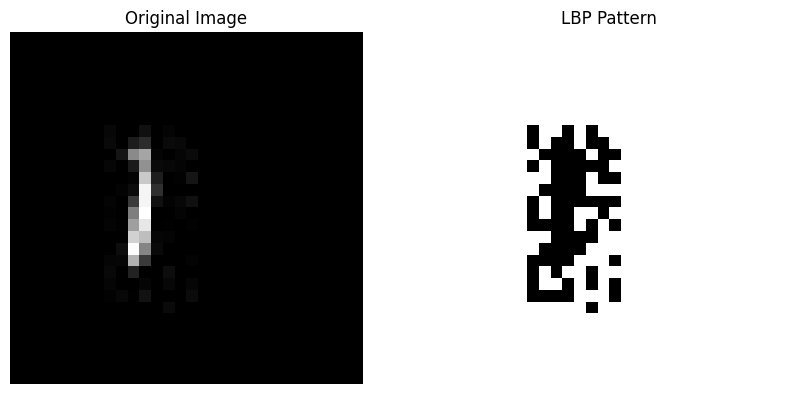

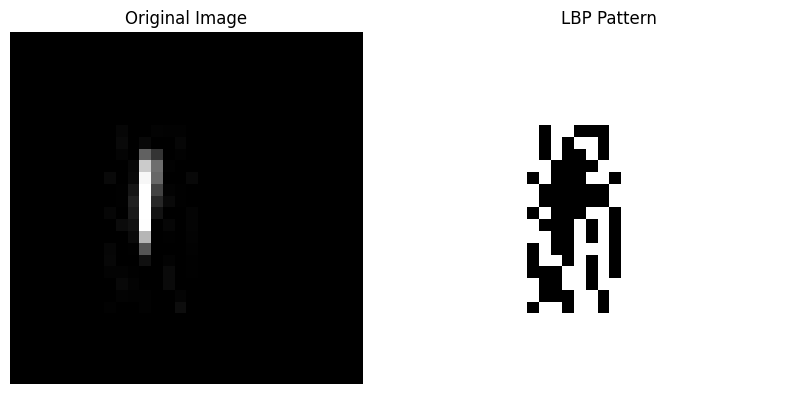

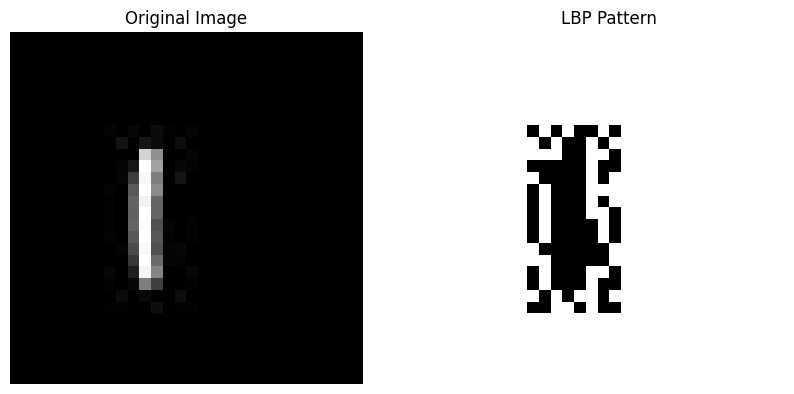

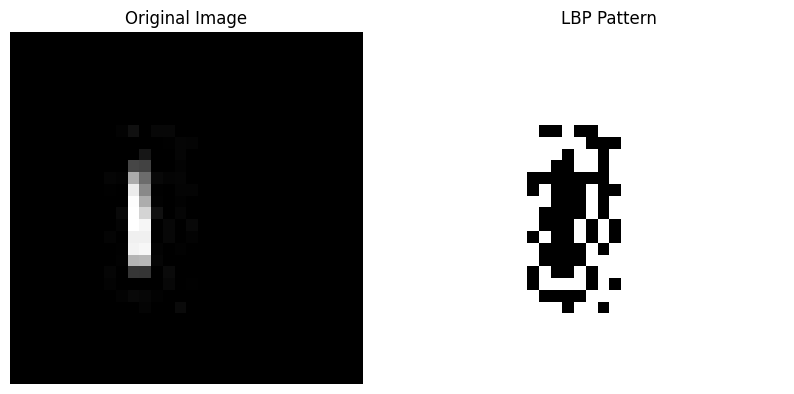

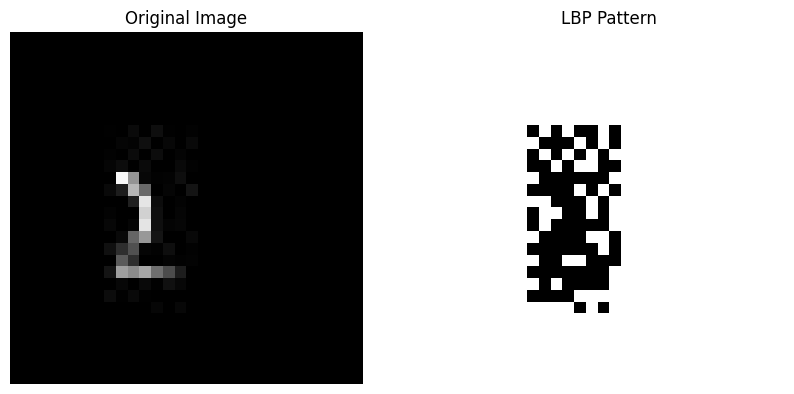

In [ ]:
radius = 1
n_points = 8 * radius
for index, row in df.head().iterrows():
    # Load the image
    filepath = row['Filepath']
    image = cv2.imread(filepath)

    # Convert image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Calculate LBP
    lbp = local_binary_pattern(gray, radius, n_points, method='uniform')

    # Create a new figure and subplot axes
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Plot original image
    axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image')
    axes[0].axis('off')

    # Plot LBP pattern
    axes[1].imshow(lbp, cmap='gray')
    axes[1].set_title('LBP Pattern')
    axes[1].axis('off')

    # Show the plot for the current image
    plt.show()

**Mean Calculations for Easy Normalizations**

In [ ]:
def mean_pixel(column):
  modified_rows = []

  for row in column:
    total_pixels = sum(row)
    sum_products = sum(intensity * frequency for intensity, frequency in enumerate(row))
    mean = sum_products / total_pixels
    modified_rows.append(mean)

  return modified_rows

In [ ]:
def calculate_mean(column):

  modified_rows = []

  for row in column:
    arr = np.array(row)
    mean_value = np.mean(arr)
    modified_rows.append(mean_value)

  return modified_rows

In [ ]:
def mean_contours(contours):

    mean_contours = []

    for row_contours_tuple in contours:
        # Extract numpy array from tuple
        row_contours = row_contours_tuple[0]

        # Reshape to 2D array for MinMaxScaler
        row_contours_2d = np.array(row_contours).reshape(-1, 2)

        mean_value = np.mean(row_contours_2d)
        mean_contours.append(float(f'{mean_value:.6f}'))

    return mean_contours

In [ ]:
list_col = ['HOG', 'Hu_Moments', 'LBP', 'Gradient_Magnitude', 'Gradient_Direction', 'Orientation_Histogram']
df['Pixel_Intensity_Histogram'] = mean_pixel(df['Pixel_Intensity_Histogram'])
for i in list_col:
  df[i] = calculate_mean(df[i])
df['Contours'] = mean_contours(df['Contours'])
df.head()

,Filename,Filepath,Owner,Pixel_Intensity_Histogram,HOG,Hu_Moments,LBP,Mean_Value,Std_Dev,Variance,Skewness,Kurtosis,Gradient_Magnitude,Gradient_Direction,Orientation_Histogram,Mean_Curvature,Contours
0,Yan Hao_crop_0_0.jpg,/content/output_crops/Yan Hao_crop_0_0.jpg,Yan Hao,3.976667,0.098744,0.000440,0.090909,3.976667,17.705759,313.493900,5.373355,30.795687,48.942767,1.540967,97.555556,-17051.001087,12.437500
1,Yan Hao_crop_0_1.jpg,/content/output_crops/Yan Hao_crop_0_1.jpg,Yan Hao,1.991111,0.089328,0.000479,0.090909,1.991111,10.659994,113.635477,6.399988,43.152520,34.642822,1.600000,98.555556,-14450.000236,12.500000
2,Yan Hao_crop_0_2.jpg,/content/output_crops/Yan Hao_crop_0_2.jpg,Yan Hao,4.264444,0.094176,0.000524,0.090909,4.264444,17.723276,314.114514,4.855182,24.279553,51.927856,1.411450,97.555556,-32946.000283,12.833333
3,Yan Hao_crop_0_3.jpg,/content/output_crops/Yan Hao_crop_0_3.jpg,Yan Hao,4.254444,0.102640,0.000261,0.090909,4.254444,20.807924,432.969702,5.838827,35.524919,46.471610,1.670483,98.000000,-65313.999904,13.000000
4,Yan Hao_crop_0_4.jpg,/content/output_crops/Yan Hao_crop_0_4.jpg,Yan Hao,2.844444,0.102529,0.000677,0.090909,2.844444,12.254442,150.171358,5.118488,27.303149,56.328466,2.118067,96.777778,-50863.999389,12.666667


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 720 entries, 0 to 719
Data columns (total 17 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Filename                   720 non-null    object 
 1   Filepath                   720 non-null    object 
 2   Owner                      720 non-null    object 
 3   Pixel_Intensity_Histogram  720 non-null    float64
 4   HOG                        720 non-null    float64
 5   Hu_Moments                 720 non-null    float64
 6   LBP                        720 non-null    float64
 7   Mean_Value                 720 non-null    float64
 8   Std_Dev                    720 non-null    float64
 9   Variance                   720 non-null    float64
 10  Skewness                   720 non-null    float64
 11  Kurtosis                   720 non-null    float64
 12  Gradient_Magnitude         720 non-null    float64
 13  Gradient_Direction         720 non-null    float64

**Normalization**

In [ ]:
# Normalise the numeric colums
numeric_columns = df.select_dtypes(include=['number']).columns.tolist()

# Initialize MinMaxScaler
scaler = MinMaxScaler()

df[numeric_columns] = scaler.fit_transform(df[numeric_columns])
path = df['Filepath']

# Drop columns
df = df.drop(columns=['Filename','Filepath'])
df.head()

,Owner,Pixel_Intensity_Histogram,HOG,Hu_Moments,LBP,Mean_Value,Std_Dev,Variance,Skewness,Kurtosis,Gradient_Magnitude,Gradient_Direction,Orientation_Histogram,Mean_Curvature,Contours
0,Yan Hao,0.016376,0.430443,0.433350,0.606414,0.016376,0.085674,0.018998,0.838366,0.704673,0.055376,0.326812,0.942197,0.644986,0.342033
1,Yan Hao,0.000000,0.297332,0.483173,0.424490,0.000000,0.016793,0.002739,1.000000,0.971814,0.012255,0.329664,0.994220,0.653117,0.346154
2,Yan Hao,0.018749,0.365877,0.540987,0.663265,0.018749,0.085846,0.019049,0.756784,0.563802,0.064377,0.320554,0.942197,0.595303,0.368132
3,Yan Hao,0.018667,0.485522,0.201777,0.265306,0.018667,0.116002,0.028718,0.911650,0.806914,0.047924,0.333069,0.965318,0.494128,0.379121
4,Yan Hao,0.007038,0.483955,0.738593,0.663265,0.007038,0.032381,0.005711,0.798239,0.629169,0.077647,0.354694,0.901734,0.539295,0.357143


# **Features Selection - Genetic Algorithm (GA)** <br>
**Types of fitness function : Fitness range (-1 <= x <= 1)**

    1. Logistics Regression
    2. Random Forest Classifier

    ### Penalty
    -Deduction of 0.1 is applied for each feature that exceeds the specified range(10).

**Selection methods**

    1. Tournament Selection
    2. Rank Selection

**Mutation methods**

    1. Bit Flip Mutation
    2. Gaussian Mutation

**Stopping Criteria**

    1. When fitness value > 0.998
    2. When best fitness value does not improve for 40 consecutive generations

**Changes of mutation and crossover rate every generation loop [TRUE / FALSE]**

    1. crossover_rate *= 1.05
    2. mutation_rate *= 0.99


**Splitting Data**

In [ ]:
from sklearn.model_selection import train_test_split

# Split Dataset into train and test sets
X = df.drop(['Owner'],axis = 1)
y = df['Owner']
X_train,X_test,y_train,y_test = train_test_split(
    X,
    y,
    test_size = 0.1,
    random_state = 42
)

print("Training features : ", len(X_train))
print("Testing features  : ", len(X_test))
print("Training labels   : ", len(y_train))
print("Testing labels    : ", len(y_test))

Training features :  648
Testing features  :  72
Training labels   :  648
Testing labels    :  72


**Import Libraries**

In [ ]:
!pip install deap

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from deap import base, creator, tools, algorithms
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import statistics
import random
import itertools
from itertools import product
from functools import reduce
import seaborn as sns
from sklearn.exceptions import ConvergenceWarning
import warnings
import sys

# Suppress convergence warnings
warnings.filterwarnings("ignore", category=ConvergenceWarning)

**Set Up Fitness Functions**

In [ ]:
# Deduct fitness score when the number of features > 10
# Penalty of 0.1 is applied for each feature that exceeds the specified range.
def penalty_function(selected_features,score):
    num_features = len(selected_features)
    if num_features > 10:
      score -= (num_features - 10) /10
    return score

def fitness_function_random_forest(individual,data,target):
  # Filter the features based on the individual's chromosome
  selected_features = [feature for feature,bit in zip(data.columns,individual) if bit == 1]
  if not selected_features:
    return (0.0,)
  X = data[selected_features]
  model = RandomForestClassifier(random_state = 42)
  model.fit(X,target)
  score =model.score(X_test[selected_features],y_test)

  score = penalty_function(selected_features,score)

  return (score,)

def fitness_function_logistics_regression(individual,data,target):
  selected_features = [feature for feature,bit in zip(data.columns,individual) if bit == 1]
  if not selected_features:
    return (0.0,)
  X = data[selected_features]
  model = LogisticRegression()
  model.fit(X,target)
  pred = model.predict(X_test[selected_features])
  acc = accuracy_score(y_test,pred)

  acc = penalty_function(selected_features,acc)

  return (acc,)

**Set Up Genetic Algorithm**

In [ ]:
# Define a random state seed
RANDOM_SEED = 42
random.seed(RANDOM_SEED)
np.random.seed(RANDOM_SEED)

def feature_selection_genetic_algo(data,features,target,population_size,num_generations,fitness_type,num_desired_features = 10,selection_type = 'tournament',mutation_type = 'bitflip',crossover_rate = 0.7,mutation_rate = 0.01,changes_of_rates = True):
  collection_of_fitnesses = []
  best_fitness_in_generation = -sys.float_info.max
  best_ind_in_generation = None

  # Create the Fitness and Individual classes
  creator.create("FitnessMax",base.Fitness,weights = (1.0,))
  creator.create("Individual",list,fitness = creator.FitnessMax)

  # Initialize the toolbox
  toolbox = base.Toolbox()

  # Attribute generator: Define a function to randomly generate a feature selector (0 or 1)
  toolbox.register('attr_bool',random.randint,0,1)

  # Structure initializers: Define a function to create individuals and the population
  # toolbox.register('individual',init_individual,creator.Individual,size = len(features),num_features = 10)
  toolbox.register('individual',tools.initRepeat, creator.Individual, toolbox.attr_bool, n=len(features))
  toolbox.register('population',tools.initRepeat,list,toolbox.individual)

  # Register the evaluation function
  if fitness_type == 'randomforest':
    toolbox.register("evaluate",fitness_function_random_forest,data = data,target = target)
  elif fitness_type == 'logistic':
    toolbox.register("evaluate",fitness_function_logistics_regression,data = data,target = target)

  toolbox.register('mate',tools.cxTwoPoint)

  if mutation_type == 'bitflip':
    toolbox.register('mutate',tools.mutFlipBit,indpb = 0.05)
  elif mutation_type == 'gaussian':
    toolbox.register('mutate',tools.mutGaussian,mu = 0,sigma = 1,indpb = 0.5)

  if selection_type == 'tournament':
    toolbox.register('select',tools.selTournament,tournsize  = 3)
  elif selection_type == 'rank':
    toolbox.register('select',tools.selBest)

  # Initialize population
  population = toolbox.population(n = population_size)

  fitnesses = list(map(toolbox.evaluate,population))

  for ind,fit in zip(population,fitnesses):
    ind.fitness.values = fit

  # Variable keeping track of the number of generations
  gen = 0

  count_num_gen = 0

  while gen < num_generations:

    gen+=1

    # Select the next generation individuals
    offspring = toolbox.select(population,len(population))

    # Clone the selected individuals
    offspring = list(map(toolbox.clone,offspring))

    # Apply crossover and mutation on the offspring
    for child1,child2 in zip(offspring[::2],offspring[1::2]):
      if random.random() < crossover_rate:
        toolbox.mate(child1,child2)
        del child1.fitness.values
        del child2.fitness.values

    for mutant in offspring:
      if random.random() < mutation_rate:
        toolbox.mutate(mutant)
        del mutant.fitness.values

    # Evaluate the individuals with an invalid fitness
    invalid_ind = [ind for ind in offspring if not ind.fitness.valid]

    fitnesses = map(toolbox.evaluate,invalid_ind)

    for ind,fit in zip(invalid_ind,fitnesses):
      ind.fitness.values = fit

    # Replace the population with the offspring
    population[:] = offspring

    # Stopping criteria
    try:
      best_ind_in_population = tools.selBest(population,1)[0]
      best_fitness_in_population = best_ind_in_population.fitness.values[0]
    except IndexError:
      break

    selected_features = [feature for feature,bit in zip(data.columns,best_ind_in_population) if bit == 1]

    if changes_of_rates:
        #  Modify crossover rate and mutation -rate every generation loop
        crossover_rate *= 1.05
        mutation_rate *= 0.99

    collection_of_fitnesses.append(best_fitness_in_population)

    if best_fitness_in_population > best_fitness_in_generation:
      best_fitness_in_generation = best_fitness_in_population
      best_ind_in_generation = best_ind_in_population
      count_num_gen = 0
    else:
      count_num_gen += 1

    if best_fitness_in_population >= 0.998:
      print("\n Met Stopping Criteria - best_fitness_in_population >= 0.998")
      break

    if count_num_gen == 40:
      print("\nMet Stopping Criteria - count_num_gen == 40")
      break

  # Select the top N features from the best individual
  selected_features = [features[i] for i in range(len(best_ind_in_generation)) if best_ind_in_generation[i] == 1]

  if len(selected_features) > num_desired_features:
    X = data[selected_features]
    model = RandomForestClassifier()
    model.fit(X,target)
    feature_importances = model.feature_importances_
    important_features = sorted(zip(selected_features,feature_importances),key = lambda x : x[1],reverse = True)
    best_features = [feature for feature,importance in important_features[:num_desired_features]]
  else:
    best_features = selected_features

  return collection_of_fitnesses,best_features,best_fitness_in_generation

In [ ]:
# Plot the convergence
def plot_fitness_history(fitnesses,title):
  plt.plot(fitnesses)
  plt.xlabel("Generation")
  plt.ylabel("Best Fitness Value")
  plt.title(title)
  plt.grid()
  plt.show()

In [ ]:
def run_feature_selection_ga(setting,title,data,feature,target,population_size,num_generations,
                             fitness_type,num_desired_features,selection_type,mutation_type,
                             crossover_rate,mutation_rate,changes_of_rates):

  fitnesses,best_features,best_fitness = feature_selection_genetic_algo(data,
                                                                      features,
                                                                      target,
                                                                      population_size,
                                                                      num_generations,
                                                                      fitness_type,
                                                                      num_desired_features,
                                                                      selection_type,
                                                                      mutation_type,
                                                                      crossover_rate,
                                                                      mutation_rate,
                                                                      changes_of_rates)

  all_best_fitness.append(best_fitness)
  all_best_features.append(best_features)
  print("\nSetting        : ", setting)
  print("Best Features  : ", best_features)
  print("Best Fitness   : ", best_fitness)
  plot_fitness_history(fitnesses, title)

In [ ]:
# Parameters
data = X_train
features = X_train.columns
target = y_train
num_desired_features = 10
population_size = 30
num_generations = 80

all_best_fitness = []
all_best_features = []

**Fitness Function with Logistic Regression**

**Fixed MUL,Sel Rates**


Met Stopping Criteria - count_num_gen == 40

Setting        :  ['logistic', 'tournament', 'bitflip', 0.7, 0.1, False]
Best Features  :  ['HOG', 'LBP', 'Variance', 'Contours']
Best Fitness   :  0.9444444444444444


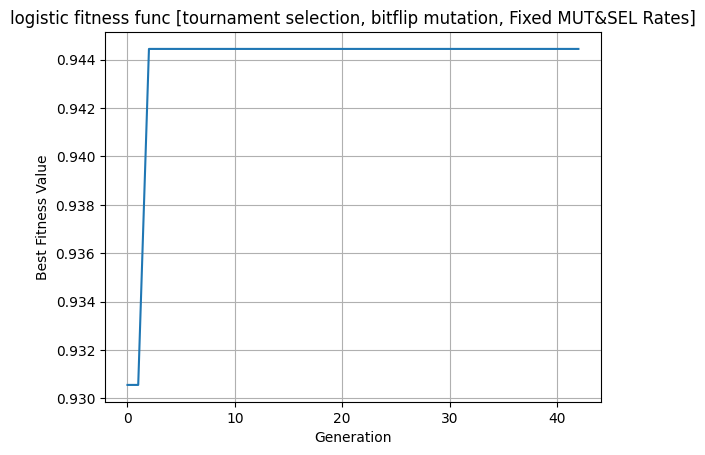

/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'FitnessMax' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "



Met Stopping Criteria - count_num_gen == 40

Setting        :  ['logistic', 'rank', 'bitflip', 0.7, 0.1, False]
Best Features  :  ['Pixel_Intensity_Histogram', 'HOG', 'LBP', 'Std_Dev', 'Orientation_Histogram', 'Mean_Curvature', 'Contours']
Best Fitness   :  0.9444444444444444


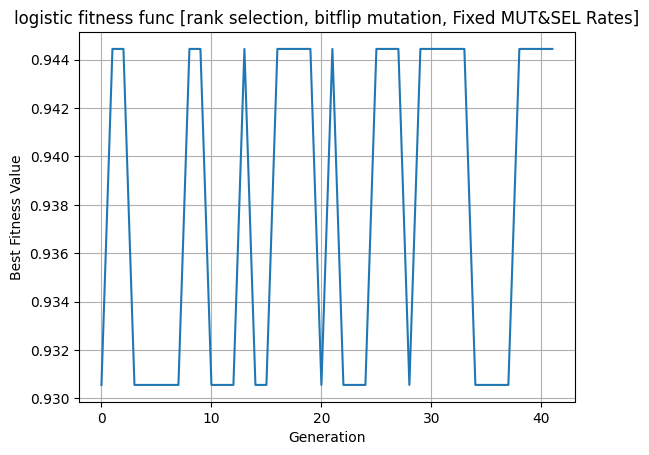

In [ ]:
settingsLog1 = [
    # Dataset,features,target,population_size,number of generation, fitness type, number of desired features, selection type, mutation type,
    # crossover rate, mutation rate, changes of rates:bool
    [data,features,target,population_size,num_generations,'logistic',num_desired_features,'tournament','bitflip',0.7,0.1,False],
    [data,features,target,population_size,num_generations,'logistic',num_desired_features,'rank','bitflip',0.7,0.1,False],
]

for setting in settingsLog1:
    fitness_type = setting[5]
    selection_type = setting[7]
    mutation_type = setting[8]
    crossover_rate = setting[9]
    mutation_rate = setting[10]
    changes_of_rates = setting[11]

    if changes_of_rates:
      title = f"{fitness_type} fitness func [{selection_type} selection, {mutation_type} mutation, Dynamic MUT&SEL Rates]"
    else:
      title = f"{fitness_type} fitness func [{selection_type} selection, {mutation_type} mutation, Fixed MUT&SEL Rates]"

    setting = [fitness_type,selection_type,mutation_type,crossover_rate,mutation_rate,changes_of_rates]
    run_feature_selection_ga(setting,title,data,features,target,population_size,num_generations,fitness_type,num_desired_features,selection_type,mutation_type,
                            crossover_rate,mutation_rate,changes_of_rates)
    print()

**Dynamic MUL&SEL Rate**

/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'FitnessMax' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "



Met Stopping Criteria - count_num_gen == 40

Setting        :  ['logistic', 'tournament', 'gaussian', 0.7, 0.1, True]
Best Features  :  ['HOG', 'Mean_Value', 'Std_Dev', 'Variance', 'Contours']
Best Fitness   :  0.9444444444444444


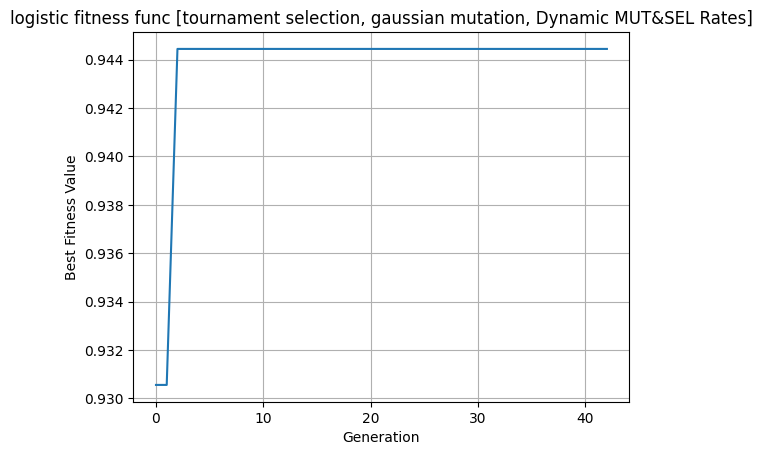

/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'FitnessMax' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "



Met Stopping Criteria - count_num_gen == 40

Setting        :  ['logistic', 'rank', 'gaussian', 0.7, 0.1, True]
Best Features  :  ['Pixel_Intensity_Histogram', 'HOG', 'Std_Dev', 'Variance', 'Contours']
Best Fitness   :  0.9444444444444444


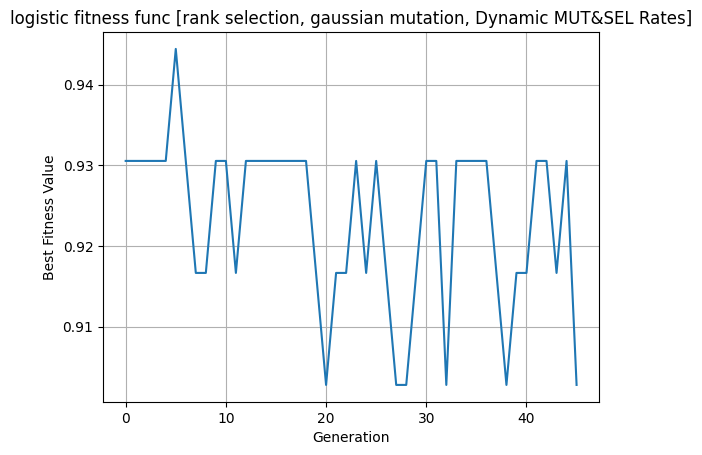

In [ ]:
settingsLog2 = [
    # Dataset,features,target,population_size,number of generation, fitness type, number of desired features, selection type, mutation type,
    # crossover rate, mutation rate, changes of rates:bool
    [data,features,target,population_size,num_generations,'logistic',num_desired_features,'tournament','gaussian',0.7,0.1,True],
    [data,features,target,population_size,num_generations,'logistic',num_desired_features,'rank','gaussian',0.7,0.1,True],
]

for setting in settingsLog2:
    fitness_type = setting[5]
    selection_type = setting[7]
    mutation_type = setting[8]
    crossover_rate = setting[9]
    mutation_rate = setting[10]
    changes_of_rates = setting[11]

    if changes_of_rates:
      title = f"{fitness_type} fitness func [{selection_type} selection, {mutation_type} mutation, Dynamic MUT&SEL Rates]"
    else:
      title = f"{fitness_type} fitness func [{selection_type} selection, {mutation_type} mutation, Fixed MUT&SEL Rates]"

    setting = [fitness_type,selection_type,mutation_type,crossover_rate,mutation_rate,changes_of_rates]
    run_feature_selection_ga(setting,title,data,features,target,population_size,num_generations,fitness_type,num_desired_features,selection_type,mutation_type,
                            crossover_rate,mutation_rate,changes_of_rates)
    print()

In [ ]:
best_fitness_value_index_logisticRegression = np.argmax(all_best_fitness)

logistic_best_features = all_best_features[best_fitness_value_index_logisticRegression]
logistic_best_fitness = all_best_fitness[best_fitness_value_index_logisticRegression]

all_settings = settingsLog1 + settingsLog2
print(best_fitness_value_index_logisticRegression)
best_setting = [all_settings[best_fitness_value_index_logisticRegression][5],
      all_settings[best_fitness_value_index_logisticRegression][7],
      all_settings[best_fitness_value_index_logisticRegression][8],
      all_settings[best_fitness_value_index_logisticRegression][9],
      all_settings[best_fitness_value_index_logisticRegression][10],
      all_settings[best_fitness_value_index_logisticRegression][11]]

print("Logistic Regression ")
print("Best Settings      - ", best_setting)
print("Best Fitness Value - ", logistic_best_fitness)
print("Best Features      - ", logistic_best_features)

0
Logistic Regression 
Best Settings      -  ['logistic', 'tournament', 'bitflip', 0.7, 0.1, False]
Best Fitness Value -  0.9444444444444444
Best Features      -  ['HOG', 'LBP', 'Variance', 'Contours']


**Comparison with Feature Importance**

In [ ]:
# Train a Logistic Regression model
lr_feature_importance_model = LogisticRegression(max_iter=1000)
lr_feature_importance_model.fit(X_train, y_train)

# Get feature importances (absolute values of coefficients)
importances = np.abs(lr_feature_importance_model.coef_[0])

# Create a DataFrame for better visualization
lr_feature_importance_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': importances
}).sort_values(by='Importance', ascending=False)

lr_feature_importance_df.reset_index(drop=True, inplace=True)

# Print the DataFrame to see the top 15 feature importances
lr_feature_importance_df.head(15)

,Feature,Importance
0,Hu_Moments,3.598666
1,Std_Dev,3.379675
2,Variance,2.736980
3,Contours,2.459770
4,Mean_Value,1.496993
5,Pixel_Intensity_Histogram,1.496993
6,Mean_Curvature,1.316580
7,Gradient_Direction,1.148518
8,Orientation_Histogram,0.849637
9,HOG,0.659549


<ipython-input-47-b39d85f6fb36>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=lr_feature_importance_df[:20], palette='viridis')


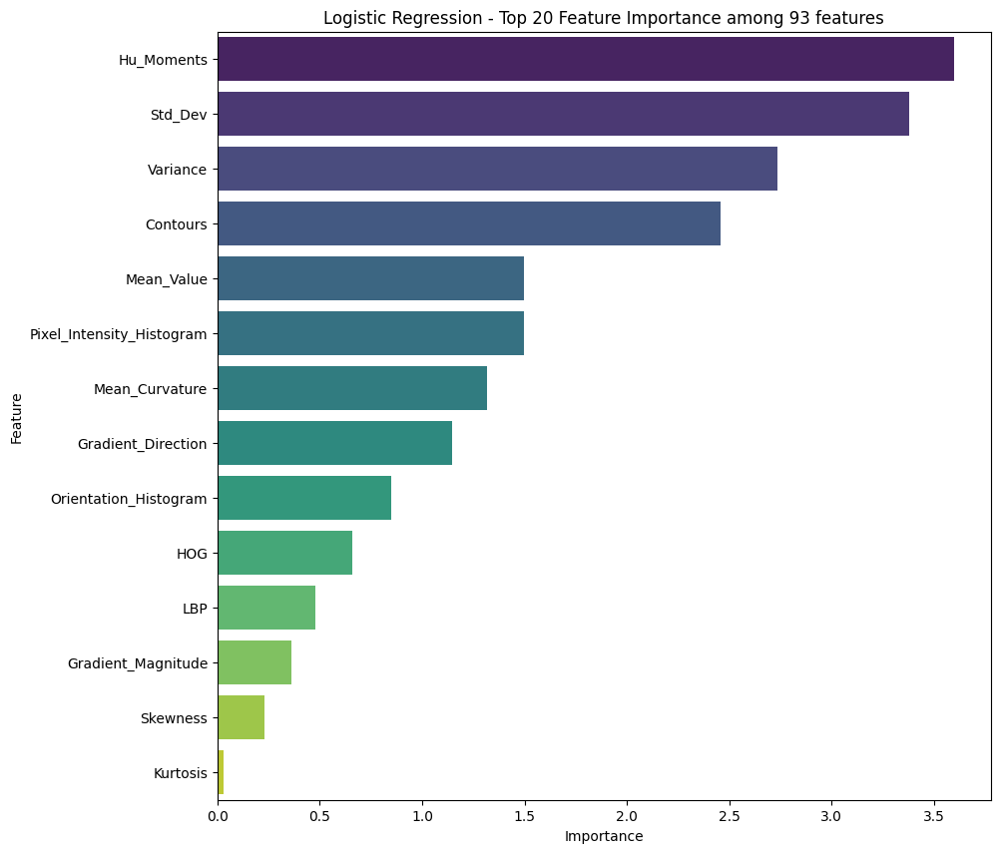

In [ ]:
# Plotting feature importance charts
# Plotting
plt.figure(figsize=(10, 10))
sns.barplot(x='Importance', y='Feature', data=lr_feature_importance_df[:20], palette='viridis')
plt.title('Logistic Regression - Feature Importance among 14 features')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

In [ ]:
# Compare the selected feature by the genetic algorithms and Logistic Regression
print("Logistic Regression Best Fitness" , logistic_best_fitness)

print()
for idx,feature in enumerate(logistic_best_features):
  print('Feature ',(idx + 1), " : ", feature)
  print("Rank : ", lr_feature_importance_df[lr_feature_importance_df['Feature'] == feature].index[0])
  print("Feature Importance value : ", lr_feature_importance_df[lr_feature_importance_df['Feature'] == feature]['Importance'].iloc[0])
  print()

Logistic Regression Best Fitness 0.9444444444444444

Feature  1  :  HOG
Rank :  9
Feature Importance value :  0.6595488103161062

Feature  2  :  LBP
Rank :  10
Feature Importance value :  0.4796523532283006

Feature  3  :  Variance
Rank :  2
Feature Importance value :  2.736979636006649

Feature  4  :  Contours
Rank :  3
Feature Importance value :  2.4597695917475124



**Fitness Function with Random Forest Classifier**

**Fixed MUL,Sel Rates**

In [ ]:
all_best_features = []
all_best_fitness = []

/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'FitnessMax' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "



Met Stopping Criteria - count_num_gen == 40

Setting        :  ['randomforest', 'tournament', 'bitflip', 0.7, 0.1, False]
Best Features  :  ['HOG', 'Hu_Moments', 'Std_Dev', 'Gradient_Magnitude', 'Orientation_Histogram']
Best Fitness   :  0.9861111111111112


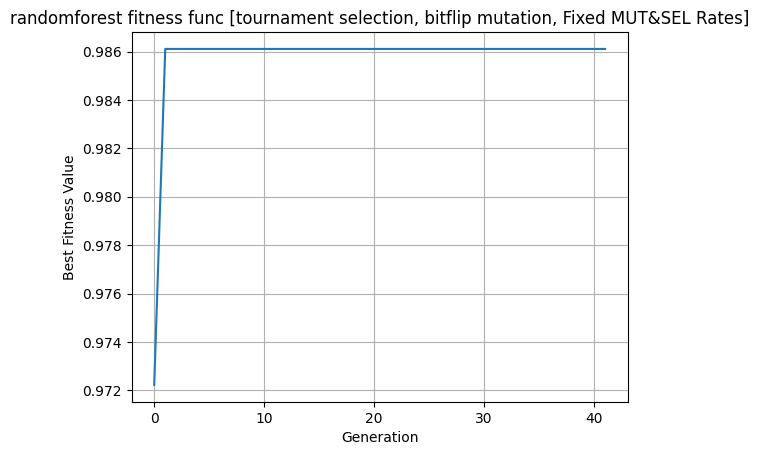

/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'FitnessMax' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "



Met Stopping Criteria - count_num_gen == 40

Setting        :  ['randomforest', 'rank', 'bitflip', 0.7, 0.1, False]
Best Features  :  ['HOG', 'Hu_Moments', 'LBP', 'Variance', 'Kurtosis', 'Gradient_Magnitude', 'Gradient_Direction', 'Orientation_Histogram', 'Contours']
Best Fitness   :  0.9861111111111112


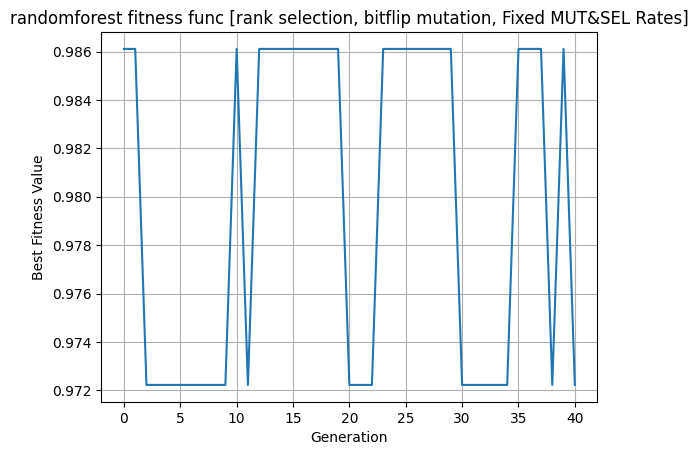

In [ ]:
settingsRanFor1 = [
    # Dataset,features,target,population_size,number of generation, fitness type, number of desired features, selection type, mutation type,
    # crossover rate, mutation rate, changes of rates:bool
    [data,features,target,population_size,num_generations,'randomforest',num_desired_features,'tournament','bitflip',0.7,0.1,False],
    [data,features,target,population_size,num_generations,'randomforest',num_desired_features,'rank','bitflip',0.7,0.1,False],
]

for setting in settingsRanFor1:
    fitness_type = setting[5]
    selection_type = setting[7]
    mutation_type = setting[8]
    crossover_rate = setting[9]
    mutation_rate = setting[10]
    changes_of_rates = setting[11]

    if changes_of_rates:
      title = f"{fitness_type} fitness func [{selection_type} selection, {mutation_type} mutation, Dynamic MUT&SEL Rates]"
    else:
      title = f"{fitness_type} fitness func [{selection_type} selection, {mutation_type} mutation, Fixed MUT&SEL Rates]"

    setting = [fitness_type,selection_type,mutation_type,crossover_rate,mutation_rate,changes_of_rates]
    run_feature_selection_ga(setting,title,data,features,target,population_size,num_generations,fitness_type,num_desired_features,selection_type,mutation_type,
                            crossover_rate,mutation_rate,changes_of_rates)
    print()

**Dynamic MUL&SEL Rate**

/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'FitnessMax' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "



Met Stopping Criteria - count_num_gen == 40

Setting        :  ['randomforest', 'tournament', 'gaussian', 0.7, 0.1, True]
Best Features  :  ['HOG', 'Hu_Moments', 'Variance', 'Skewness', 'Gradient_Direction', 'Orientation_Histogram']
Best Fitness   :  0.9861111111111112


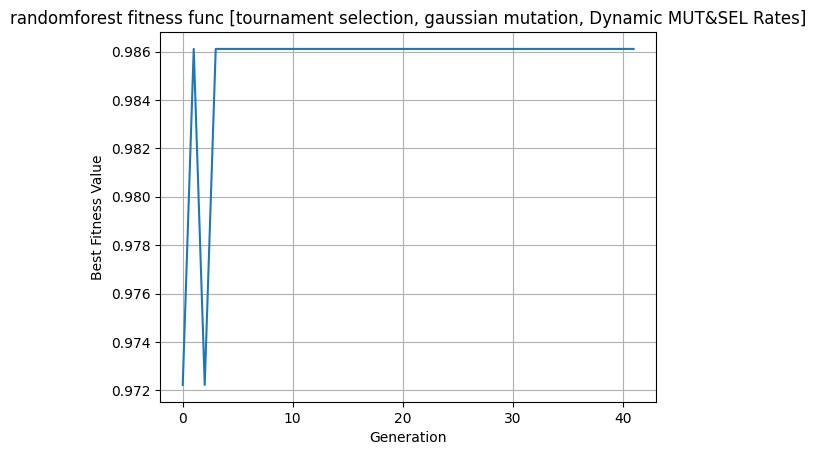

/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'FitnessMax' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
/usr/local/lib/python3.10/dist-packages/deap/creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "



Met Stopping Criteria - count_num_gen == 40

Setting        :  ['randomforest', 'rank', 'gaussian', 0.7, 0.1, True]
Best Features  :  ['Pixel_Intensity_Histogram', 'HOG', 'Hu_Moments', 'Std_Dev', 'Skewness', 'Kurtosis', 'Gradient_Magnitude', 'Orientation_Histogram', 'Mean_Curvature', 'Contours']
Best Fitness   :  0.9861111111111112


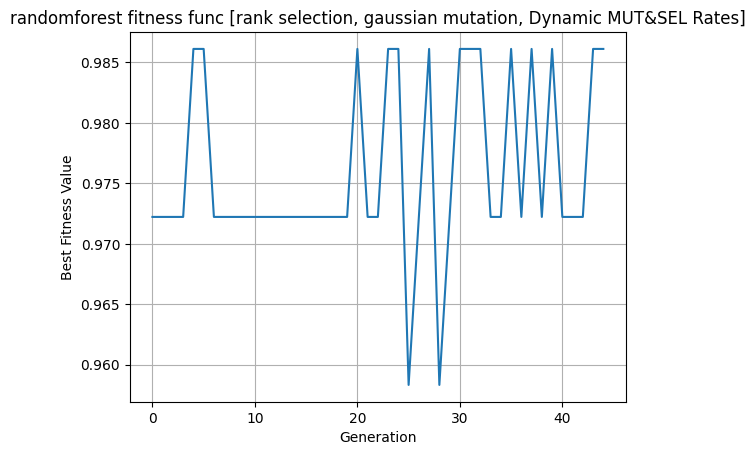

In [ ]:
settingsRanFor2 = [
    # Dataset,features,target,population_size,number of generation, fitness type, number of desired features, selection type, mutation type,
    # crossover rate, mutation rate, changes of rates:bool
    [data,features,target,population_size,num_generations,'randomforest',num_desired_features,'tournament','gaussian',0.7,0.1,True],
    [data,features,target,population_size,num_generations,'randomforest',num_desired_features,'rank','gaussian',0.7,0.1,True],
]

for setting in settingsRanFor2:
    fitness_type = setting[5]
    selection_type = setting[7]
    mutation_type = setting[8]
    crossover_rate = setting[9]
    mutation_rate = setting[10]
    changes_of_rates = setting[11]

    if changes_of_rates:
      title = f"{fitness_type} fitness func [{selection_type} selection, {mutation_type} mutation, Dynamic MUT&SEL Rates]"
    else:
      title = f"{fitness_type} fitness func [{selection_type} selection, {mutation_type} mutation, Fixed MUT&SEL Rates]"

    setting = [fitness_type,selection_type,mutation_type,crossover_rate,mutation_rate,changes_of_rates]
    run_feature_selection_ga(setting,title,data,features,target,population_size,num_generations,fitness_type,num_desired_features,selection_type,mutation_type,
                            crossover_rate,mutation_rate,changes_of_rates)
    print()

In [ ]:
best_fitness_value_index_randomForest = np.argmax(all_best_fitness)

randomForest_best_features = all_best_features[best_fitness_value_index_randomForest]
randomForest_best_fitness = all_best_fitness[best_fitness_value_index_randomForest]

# all_settings = settingsRanFor1 + settingsRanFor2
all_settings = settingsRanFor1
best_setting = [all_settings[best_fitness_value_index_randomForest][5],
      all_settings[best_fitness_value_index_randomForest][7],
      all_settings[best_fitness_value_index_randomForest][8],
      all_settings[best_fitness_value_index_randomForest][9],
      all_settings[best_fitness_value_index_randomForest][10],
      all_settings[best_fitness_value_index_randomForest][11]]

print("Random Forest Classifier")
print("Best Settings      - ", best_setting)
print("Best Fitness Value - ", randomForest_best_fitness)
print("Best Features      - ", randomForest_best_features)

Random Forest Classifier
Best Settings      -  ['randomforest', 'tournament', 'bitflip', 0.7, 0.1, False]
Best Fitness Value -  0.9861111111111112
Best Features      -  ['HOG', 'Hu_Moments', 'Std_Dev', 'Gradient_Magnitude', 'Orientation_Histogram']


**Comparison with Feature Importance**

In [ ]:
# Train a Random Forest model
feature_importance_model = RandomForestClassifier(random_state=42)
feature_importance_model.fit(X_train, y_train)

# Get feature importances
importances = feature_importance_model.feature_importances_

# Create a DataFrame for better visualization
feature_importance_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': importances
}).sort_values(by='Importance', ascending=False)

feature_importance_df.reset_index(drop=True, inplace=True)

# Print the feature importances
feature_importance_df.head(15)

,Feature,Importance
0,Std_Dev,0.159546
1,Variance,0.158797
2,Mean_Value,0.120377
3,Pixel_Intensity_Histogram,0.116151
4,Skewness,0.097980
5,Gradient_Magnitude,0.090928
6,Kurtosis,0.082451
7,Orientation_Histogram,0.041678
8,Hu_Moments,0.040827
9,Contours,0.029353


<ipython-input-54-19f489cf541f>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df[:20], palette='viridis')


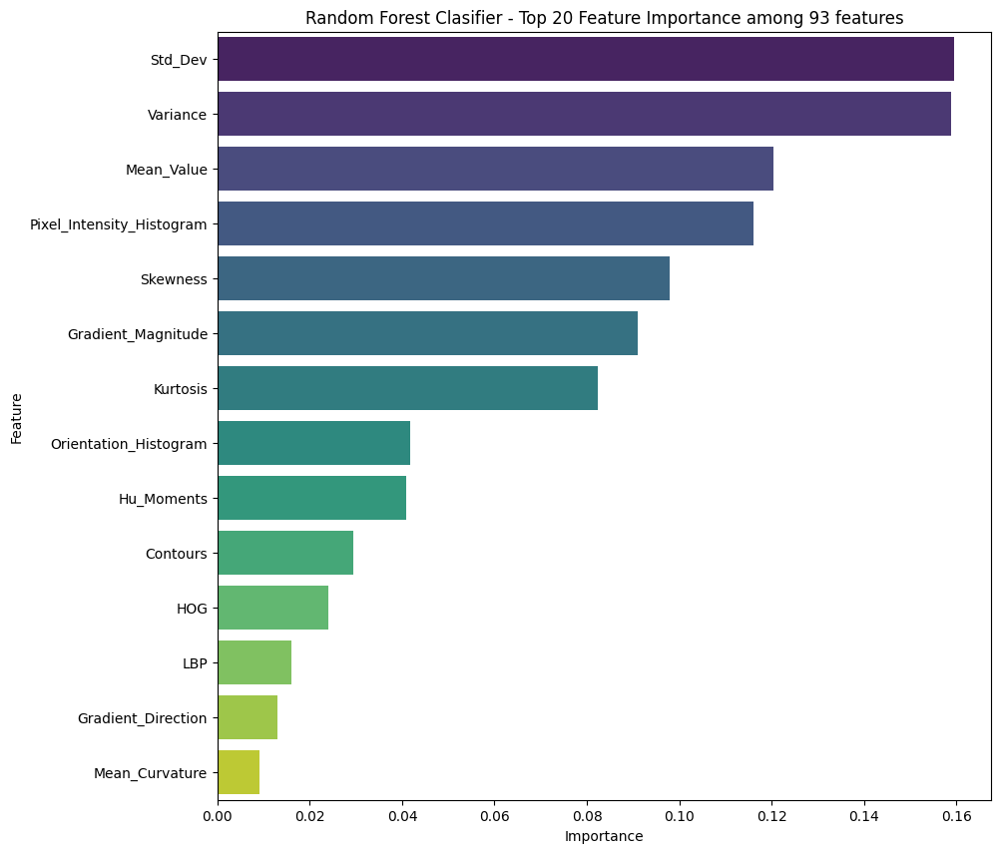

In [ ]:
# plotting Feature importance charts
# Plotting
plt.figure(figsize=(10, 10))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df[:20], palette='viridis')
plt.title('Random Forest Clasifier - Feature Importance among 14 features')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

In [ ]:
# Compare the selected feature by the genetic algorithms and Random Forest Classifier
print("Random Forest Best Fitness" , randomForest_best_fitness)

print()

for idx,feature in enumerate(randomForest_best_features):
  print('Feature ',(idx + 1), " : ", feature)
  print("Rank : ", feature_importance_df[feature_importance_df['Feature'] == feature].index[0])
  print("Feature Importance value : ", feature_importance_df[feature_importance_df['Feature'] == feature]['Importance'].iloc[0])
  print()

Random Forest Best Fitness 0.9861111111111112

Feature  1  :  HOG
Rank :  10
Feature Importance value :  0.02393955883848601

Feature  2  :  Hu_Moments
Rank :  8
Feature Importance value :  0.040827108913024754

Feature  3  :  Std_Dev
Rank :  0
Feature Importance value :  0.15954593994109065

Feature  4  :  Gradient_Magnitude
Rank :  5
Feature Importance value :  0.09092770243481792

Feature  5  :  Orientation_Histogram
Rank :  7
Feature Importance value :  0.041677643827716035



**Dataset with Best Features Selected**

In [ ]:
df = pd.concat([path, y, X[randomForest_best_features]], axis=1)
df.head()

,Filepath,Owner,HOG,Hu_Moments,Std_Dev,Gradient_Magnitude,Orientation_Histogram
0,/content/output_crops/Yan Hao_crop_0_0.jpg,Yan Hao,0.430443,0.433350,0.085674,0.055376,0.942197
1,/content/output_crops/Yan Hao_crop_0_1.jpg,Yan Hao,0.297332,0.483173,0.016793,0.012255,0.994220
2,/content/output_crops/Yan Hao_crop_0_2.jpg,Yan Hao,0.365877,0.540987,0.085846,0.064377,0.942197
3,/content/output_crops/Yan Hao_crop_0_3.jpg,Yan Hao,0.485522,0.201777,0.116002,0.047924,0.965318
4,/content/output_crops/Yan Hao_crop_0_4.jpg,Yan Hao,0.483955,0.738593,0.032381,0.077647,0.901734


In [ ]:
df1 = df.copy()

In [ ]:
sem_df = df[df["Owner"] == "Yee Sem"]
ho_df = df[df["Owner"] == "Yan Ho"]
hao_df = df[df["Owner"] == "Yan Hao"]
hui_df = df[df["Owner"] == "Hui Yi"]
jin_df = df[df["Owner"] == "Jin Khye"]

In [ ]:
# List to hold all data
all_data = []

# # Define a list of the dataframes to iterate over
# df_list = [sem_df, hui_df, hao_df, jin_df, ho_df]

image_path, feature_col, owner_col = [], [], []
# Iterate over each dataframe to collect required data
for i in range(0,len(sem_df),4):
  for j in range(4):
      # Extract feature data
      feature_data = sem_df[randomForest_best_features].iloc[i + j].to_numpy()
      file_path = sem_df['Filepath'].iloc[i + j]
      owner = sem_df['Owner'].iloc[i + j]
      image_path.append(file_path)
      feature_col.append(feature_data)
      owner_col.append(owner)
  for j in range(4):
      # Extract feature data
      feature_data = hui_df[randomForest_best_features].iloc[i + j].to_numpy()
      file_path = hui_df['Filepath'].iloc[i + j]
      owner = hui_df['Owner'].iloc[i + j]
      image_path.append(file_path)
      feature_col.append(feature_data)
      owner_col.append(owner)
  for j in range(4):
      # Extract feature data
      feature_data = hao_df[randomForest_best_features].iloc[i + j].to_numpy()
      file_path = hao_df['Filepath'].iloc[i + j]
      owner = hao_df['Owner'].iloc[i + j]
      image_path.append(file_path)
      feature_col.append(feature_data)
      owner_col.append(owner)
  for j in range(4):
      # Extract feature data
      feature_data = jin_df[randomForest_best_features].iloc[i + j].to_numpy()
      file_path = jin_df['Filepath'].iloc[i + j]
      owner = jin_df['Owner'].iloc[i + j]
      image_path.append(file_path)
      feature_col.append(feature_data)
      owner_col.append(owner)
  for j in range(4):
      # Extract feature data
      feature_data = ho_df[randomForest_best_features].iloc[i + j].to_numpy()
      file_path = ho_df['Filepath'].iloc[i + j]
      owner = ho_df['Owner'].iloc[i + j]
      image_path.append(file_path)
      feature_col.append(feature_data)
      owner_col.append(owner)

# Create a dictionary for the row
for i in range(len(image_path)):
    row = {
        'Filepath': image_path[i],
        'Owner': owner_col[i],
        'Features': feature_col[i]
    }
    all_data.append(row)

# Convert list of dictionaries to a dataframe
final_df = pd.DataFrame(all_data)

# Expand Features into separate columns
# Convert 'Features' column to DataFrame
features_df = final_df['Features'].apply(pd.Series)

# Rename columns of the features DataFrame to match the random forest best feature names
features_df.columns = randomForest_best_features

# Concatenate the features DataFrame with the original DataFrame
final_df = pd.concat([final_df.drop(columns=['Features']), features_df], axis=1)

# Display the final DataFrame structure
final_df.head()

,Filepath,Owner,HOG,Hu_Moments,Std_Dev,Gradient_Magnitude,Orientation_Histogram
0,/content/output_crops/Yee Sem_crop_0_0.jpg,Yee Sem,0.592845,0.083391,0.904796,0.735370,0.312139
1,/content/output_crops/Yee Sem_crop_0_1.jpg,Yee Sem,0.557676,0.102707,0.909445,0.838292,0.184971
2,/content/output_crops/Yee Sem_crop_0_2.jpg,Yee Sem,0.575046,0.074413,0.923471,0.718267,0.445087
3,/content/output_crops/Yee Sem_crop_0_3.jpg,Yee Sem,0.581332,0.067087,0.944543,0.651986,0.421965
4,/content/output_crops/Hui Yi_crop_0_0.jpg,Hui Yi,0.286482,0.295543,0.136080,0.088177,0.942197


#**Dataset Splitting for Model**

In [ ]:
train,test = train_test_split(df1,test_size=0.1, random_state=42)

In [ ]:
# Load Images
def load_and_preprocess_image(file_path):
    # Read the image file as raw data
    img = tf.io.read_file(file_path)
    # Decode the raw data into a tensor
    img = tf.image.decode_image(img, channels=3)

    img = tf.cast(img, tf.float32) / 255.0

    img = tf.image.resize(img,(150,150))

    return img

train_image_features = train[randomForest_best_features].values
test_image_features = test[randomForest_best_features].values

label_mapping = {'Yan Ho' : 0,'Jin Khye' : 1,'Hui Yi' : 2,'Yee Sem' : 3,'Yan Hao' : 4}
label_mapping_inv = { 0 : 'Yan Ho',1 : 'Jin Khye' , 2 : 'Hui Yi' , 3 : 'Yee Sem' ,4 : 'Yan Hao' }

# Train dataset
train_image_paths = train['Filepath'].tolist()
train_label = np.array(train['Owner'].map(label_mapping))

# Test dataset
test_image_paths = test['Filepath'].tolist()
test_label =  np.array(test['Owner'].map(label_mapping))

# Load all images
train_images = [load_and_preprocess_image(path) for path in train_image_paths]
train_image_dataset = tf.data.Dataset.from_tensor_slices((train_images,train_image_features,train_label))

test_images = [load_and_preprocess_image(path) for path in test_image_paths]
test_image_dataset = tf.data.Dataset.from_tensor_slices((test_images,test_image_features,test_label))

In [ ]:
image_paths = final_df['Filepath'].tolist()
image_for_acc_calculation = [load_and_preprocess_image(path) for path in image_paths]
image_features = final_df[randomForest_best_features].values
image_label = np.array(final_df['Owner'].map(label_mapping))
dataset = tf.data.Dataset.from_tensor_slices((image_for_acc_calculation,image_features,image_label))

In [ ]:
train_batch_size = 32
test_batch_size = 4
train_dataset = train_image_dataset.shuffle(buffer_size=len(train)).batch(train_batch_size)
test_dataset = test_image_dataset.batch(test_batch_size)

In [ ]:
shape = 0
for images, features, labels in train_dataset.take(1):
    print("Images shape:", images.shape)
    print("Features shape:", features.shape)
    print("Labels shape:", labels.shape)
    shape = features.shape[1]

print("Input shape:",shape)

Images shape: (32, 150, 150, 3)
Features shape: (32, 5)
Labels shape: (32,)
Input shape: 5


In [ ]:
class_names = list(df["Owner"].unique())

print("Train set size : ",len(train_image_dataset))
print("Test set size  : ",len(test_image_dataset))
print("Train set shape : ",train_dataset.element_spec[0].shape)
print("Test set shape  : ",test_dataset.element_spec[0].shape)
print("Unique classes  :",class_names)

Train set size :  648
Test set size  :  72
Train set shape :  (None, 150, 150, 3)
Test set shape  :  (None, 150, 150, 3)
Unique classes  : ['Yan Hao', 'Jin Khye', 'Hui Yi', 'Yee Sem', 'Yan Ho']


# **Define the Model**

**Display Images**

In [ ]:
import matplotlib as mpl

def get_image_ypred_ytrue(model_1,test_dataset):
    images_list, features_list, y_true_list = [], [], []

    # Shuffle the dataset
    shuffled_test_dataset = test_dataset.shuffle(buffer_size=len(test_dataset))

    for images, features, y_true in test_dataset:
        y_pred = model_1((images, features))  # Ensure model accepts a tuple (images, features)
        images_list.append(images)
        features_list.append(features)
        y_true_list.append(y_true)

    # Stack images and features separately
    images_concat = np.concatenate([img.numpy() for img in images_list], axis=0)
    features_concat = np.concatenate([feat.numpy() for feat in features_list], axis=0)
    y_true_concat = np.concatenate([yt.numpy() for yt in y_true_list], axis=0)

    # Make predictions
    y_pred_concat = model_1((images_concat, features_concat))  # Make sure to pass concatenated images and features
    y_pred_labels = [label_mapping_inv.get(np.argmax(pred)) for pred in y_pred_concat]

    y_true_labels = [label_mapping_inv.get(yt) for yt in y_true_concat]

    return images_concat, features_concat, y_pred_labels, y_true_labels

def display_images(images, predictions, labels, title, n):
    mpl.rcParams.update(mpl.rcParamsDefault)
    fig, axes = plt.subplots(1, n, figsize=(17, 3))
    fig.suptitle(title)

    for i in range(n):
        axes[i].imshow(images[i])
        if predictions[i] == labels[i]:
          color = 'green'
        else:
          color = 'red'
        axes[i].title.set_color(color)
        axes[i].set_title(f"Pred: {predictions[i]}\nTrue: {labels[i]}")
        axes[i].axis('off')

    plt.show()

**Display Fault Prediction Images**

In [ ]:
def display_images_fault_prediction_images(fault_prediction_list):
    title = "Fault Prediction List"
    color = 'red'

    images = []
    true_label = []
    pred_label = []
    super_imposed = []
    saliency = []
    saliency_super_imposed = []

    # item[1] = Feature data (not used)
    for item in fault_prediction_list:
      images.append(item[0])
      true_label.append(item[1])
      pred_label.append(item[2])
      super_imposed.append(item[3])
      saliency.append(item[4])
      saliency_super_imposed.append(item[5])

    n = len(images)

    num_images_per_row = min(len(images),10)
    num_rows = np.ceil(len(images) / num_images_per_row).astype(int) * 4

    mpl.rcParams.update(mpl.rcParamsDefault)
    fig, axes = plt.subplots(num_rows, n, figsize=(17, 8))
    # fig.subplots_adjust(top=0.3)
    fig.suptitle(title, y = 1.02)

    for i in range(n):
        row = (i // num_images_per_row) * 4
        col = i % num_images_per_row
        axes[row,col].imshow(images[i])
        axes[row,col].title.set_color(color)
        axes[row,col].set_title(f"Pred: {pred_label[i]}\nTrue: {true_label[i]}")
        axes[row,col].axis('off')
        axes[row + 1,col].imshow(super_imposed[i])
        axes[row + 1,col].axis('off')
        axes[row + 2,col].imshow(saliency[i])
        axes[row + 2,col].axis('off')
        axes[row + 3,col].imshow(saliency_super_imposed[i])
        axes[row + 3,col].axis('off')

    plt.show()

**Display Images with GradCAM**

In [ ]:
def display_images_with_cam(model, images, features, predictions, labels, title, layer_name):
    true_label = []
    pred_label = []

    num_counts = {
    'Yee Sem': 0,
    'Hui Yi': 0,
    'Yan Hao': 0,
    'Jin Khye': 0,
    'Yan Ho': 0
    }

    true_counts = {
    'Yee Sem': 0,
    'Hui Yi': 0,
    'Yan Hao': 0,
    'Jin Khye': 0,
    'Yan Ho': 0
    }

    # Calculate the number of rows needed
    num_images_per_row = 10
    num_rows = np.ceil(len(images) / num_images_per_row).astype(int) * 4

    # Set up the figure and axes
    mpl.rcParams.update(mpl.rcParamsDefault)
    fig, axes = plt.subplots(num_rows, num_images_per_row, figsize=(20, 8 * num_rows / 4))
    fig.suptitle(title,y = 1.01)

    for i in range(len(images)):
        row = (i // num_images_per_row) * 4
        col = i % num_images_per_row

        # Display the images
        axes[row, col].imshow(images[i])
        color = 'green' if predictions[i] == labels[i] else 'red'

        axes[row, col].title.set_color(color)
        axes[row, col].set_title(f"Pred: {predictions[i]}\nTrue: {labels[i]}")
        axes[row, col].axis('off')

        # Display the CAM
        super_imposed_image = show_sample(model, images[i], features[i], labels[i], layer_name=layer_name)
        axes[row + 1, col].imshow(super_imposed_image)
        axes[row + 1, col].axis('off')

        # Display the CAM
        saliency_map,super_imposed_saliency_map = get_saliency_map(model,images[i],features[i],labels[i])
        axes[row + 2, col].imshow(saliency_map)
        axes[row + 2, col].axis('off')

        # Display the CAM
        axes[row + 3, col].imshow(super_imposed_saliency_map)
        axes[row + 3, col].axis('off')

        if color == 'red':
          #fault_prediction_images.append([images[i],features[i],labels[i],predictions[i],super_imposed_image,saliency_map,super_imposed_saliency_map])
          fault_prediction_images.append([images[i],labels[i],predictions[i],super_imposed_image,saliency_map,super_imposed_saliency_map])

        num_counts[labels[i]] += 1
        if color == 'green':
          true_counts[labels[i]] += 1

        true_label.append(labels[i])
        pred_label.append(predictions[i])

    # Remove axes for any empty subplots
    for i in range(len(images), num_images_per_row * num_rows // 4):
        row = (i // num_images_per_row) * 4
        col = i % num_images_per_row
        # for j in range(4):
        #     axes[row + j, col].axis('off')
        axes[row, col].axis('off')
        axes[row + 1, col].axis('off')
        axes[row + 2, col].axis('off')
        axes[row + 3, col].axis('off')

    # Adjust the space between rows
    plt.subplots_adjust(hspace=0.2)

    plt.tight_layout()
    plt.show()

    return num_counts,true_counts,true_label,pred_label

In [ ]:
def get_CAM(model, preprocessed_image, features, actual_label, layer_name):
    ## First, we create a model that maps the input image to the activations
    ## of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        model.inputs, [model.get_layer(layer_name).output, model.output]
    )

    ## Then, we compute the gradient of the top predicted class for our input image
    ## for the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model([preprocessed_image, features])
        pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    ## We are doing transfer learning on last layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    ## This is a vector where each entry is the mean intensity of the gradient
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    ## calculates a heatmap highlighting the regions of importance in an image
    ## for a specific
    ## predicted class by combining the output of the last convolutional layer
    ## with the pooled gradients.
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    ## For visualization purpose
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

In [ ]:
def show_sample(model,sample_image,sample_features,sample_label,layer_name):
  sample_image_processed = np.expand_dims(sample_image,axis = 0)
  sample_features_processed = np.expand_dims(sample_features,axis=0)

  activations = model.predict([sample_image_processed, sample_features_processed])

  # pred_label = np.argmax(model.predict(sample_image_processed),axis = -1)[0]

  heatmap = get_CAM(model,sample_image_processed,sample_features_processed,sample_label,layer_name)

  heatmap = cv2.resize(heatmap,
                       (sample_image.shape[0],sample_image.shape[1]))

  heatmap *= 255

  heatmap = np.clip(heatmap,0,255).astype(np.uint8)

  heatmap = cv2.applyColorMap(heatmap,cv2.COLORMAP_HOT)

  super_imposed_image = cv2.addWeighted(
      sample_image,
      0.8,
      heatmap.astype('float32'),
      2e-3,
      0.0
  )

  return super_imposed_image

**Saliency Map**

In [ ]:
def get_saliency_map(model,image,features,true_label):

    processed_image = tf.expand_dims(image,axis = 0)
    processed_features = tf.expand_dims(features, axis=0)

    with tf.GradientTape() as tape:
      inputs = tf.cast(processed_image, tf.float32)

      tape.watch(inputs)

      pred = model([inputs, processed_features])
      max_idx = tf.argmax(pred,axis = 1)
      max_score = pred[0,max_idx[0]]

    # Calculate the gradient
    gradient = tape.gradient(max_score,inputs)

    # Reduce theRGB image to grayscale
    grayscale_tensor = tf.reduce_sum(tf.abs(gradient),axis = -1)

    # Normalize the pixel values
    normalized_tensor = tf.cast(
        255 * (grayscale_tensor - tf.reduce_min(grayscale_tensor)) /
        (tf.reduce_max(grayscale_tensor) - tf.reduce_min(grayscale_tensor)),
        tf.uint8
    )

    normalized_tensor = np.squeeze(normalized_tensor)
    gradient_color =  cv2.applyColorMap(normalized_tensor,cv2.COLORMAP_VIRIDIS)
    gradient_color = gradient_color / 255.0
    image_cast = image.astype(gradient_color.dtype)
    super_imposed = cv2.addWeighted(image_cast,0.3,gradient_color,0.7,0.0)

    return gradient_color,super_imposed

**Visualize Loss and Accuracy**

In [ ]:
def plot_metrics(history,metric_name, title):
    plt.title(title)
    plt.plot(history[metric_name],color='blue',label=metric_name)
    plt.plot(history['test_' + metric_name],color='green',label='test_' + metric_name)
    plt.legend()
    plt.show()

**Accuracy Calculation for Alphanumeric**

In [ ]:
import string
import contextlib
import sys
import os

# Suppress TensorFlow logging
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
tf.get_logger().setLevel('ERROR')

@contextlib.contextmanager
def suppress_stdout_stderr():
    with open(os.devnull, 'w') as devnull:
        old_stdout = sys.stdout
        old_stderr = sys.stderr
        try:
            sys.stdout = devnull
            sys.stderr = devnull
            yield
        finally:
            sys.stdout = old_stdout
            sys.stderr = old_stderr

# '0123456789'
# 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'
digits = string.digits
letters = string.ascii_uppercase
character = [x for x in (digits[1:] + digits[0] + letters)]


# If use this pass "dataset" as dataset
def calculate_alpha_digit_acc(model, dataset):
  image_list, feature_list = [], []
  for images, features, _ in dataset:
    image_list.append(images) # len = 13320
    feature_list.append(features)

  acc = []
  error_image = []
  for i in range(0,len(image_list),20):
    m = 0
    num_true = 0
    for j in range(i,i+20):
      processed_image = np.expand_dims(image_list[j],axis = 0)
      processed_feature = np.expand_dims(feature_list[j], axis=0)
      # Suppress output during prediction
      with suppress_stdout_stderr():
        pred = model.predict([processed_image, processed_feature])
      pred_labels = label_mapping_inv.get(np.argmax(pred))
      if m < 4:
        if pred_labels == "Yee Sem":
          num_true+=1
        else:
          error_image.append(image_list[j])
      elif m < 8:
        if pred_labels == "Hui Yi":
           num_true+=1
        else:
          error_image.append(image_list[j])
      elif m < 12:
        if pred_labels == "Yan Hao":
          num_true+=1
        else:
          error_image.append(image_list[j])
      elif m < 16:
        if pred_labels == "Jin Khye":
          num_true+=1
        else:
          error_image.append(image_list[j])
      elif m < 20:
        if pred_labels == "Yan Ho":
          num_true+=1
        else:
          error_image.append(image_list[j])
      m += 1
    acc.append(round(num_true/20,3))

  return acc,error_image

def display_error_images(images):
  num_images = len(images)

  fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 2))
  fig.suptitle("Images with Prediction Error")

  for ax, img in zip(axes, images):
      ax.imshow(img)
      ax.axis('off')

  # Adjust layout to ensure there's no overlap
  plt.tight_layout()
  plt.show()


**Define Optimizer, Loss Function and Metric**

In [ ]:
# Define Optimizer and Loss Function
learning_rate = 0.0001
optimizer = tf.keras.optimizers.legacy.Adam(learning_rate = learning_rate)
loss_object = tf.keras.losses.SparseCategoricalCrossentropy()

# Define metrics
train_acc_metrics = tf.keras.metrics.SparseCategoricalAccuracy()
test_acc_metrics = tf.keras.metrics.SparseCategoricalAccuracy()

**Learning Rate with Fuzzy Logic**

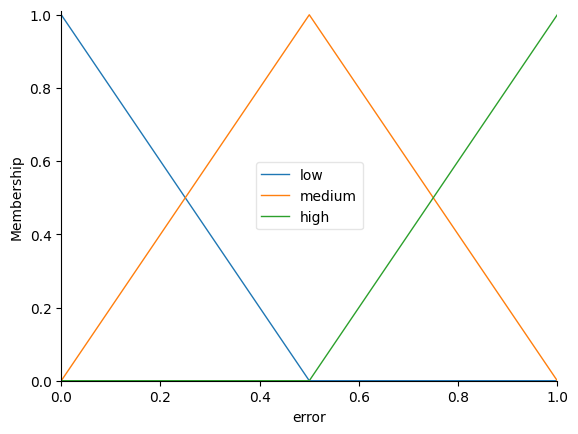

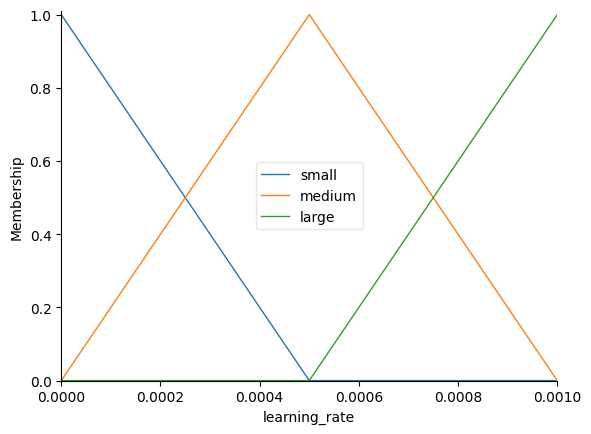

In [ ]:
# Define the fuzzy variables and membership functions using skfuzzy.control
error = ctrl.Antecedent(np.arange(0, 1.1, 0.1), 'error')
learning_rate = ctrl.Consequent(np.arange(0, 0.0011, 0.0001), 'learning_rate')

# Define membership functions for error
error['low'] = fuzz.trimf(error.universe, [0, 0, 0.5])
error['medium'] = fuzz.trimf(error.universe, [0, 0.5, 1])
error['high'] = fuzz.trimf(error.universe, [0.5, 1, 1])

# Define membership functions for learning rate
learning_rate['small'] = fuzz.trimf(learning_rate.universe, [0, 0, 0.0005])
learning_rate['medium'] = fuzz.trimf(learning_rate.universe, [0, 0.0005, 0.001])
learning_rate['large'] = fuzz.trimf(learning_rate.universe, [0.0005, 0.001, 0.001])

# Plot membership functions
error.view()
learning_rate.view()
plt.show()

# Define fuzzy rules
rules =[
    ctrl.Rule(error['low'], learning_rate['small']),
    ctrl.Rule(error['medium'], learning_rate['medium']),
    ctrl.Rule(error['high'], learning_rate['large'])
]

# Create a control system and simulation
learning_rate_ctrl = ctrl.ControlSystem(rules)
learning_rate_sim = ctrl.ControlSystemSimulation(learning_rate_ctrl)

In [ ]:
# Print the rules
print_rules(rules)

Fuzzy rules:
If error[low] THEN [learning_rate[small]]
If error[medium] THEN [learning_rate[medium]]
If error[high] THEN [learning_rate[large]]




In [ ]:
def adjust_learning_rate(error_rate):
    # Pass the error rate to the control system
    learning_rate_sim.input['error'] = error_rate

    # Compute the new learning rate
    learning_rate_sim.compute()

    # Get the output value
    new_learning_rate = learning_rate_sim.output['learning_rate']

    return new_learning_rate

**Define Gradient and Training Loop**

In [ ]:
def apply_gradient(model_1,optimizer,loss_object,x,y):
  with tf.GradientTape() as tape:
    pred = model_1(x)
    loss_value = loss_object(y_true = y,y_pred = pred)

  gradients = tape.gradient(loss_value,model_1.trainable_weights)
  optimizer.apply_gradients(zip(gradients,model_1.trainable_weights))

  return pred,loss_value

In [ ]:
def perform_validation(model_1, test_dataset):
    losses = []
    for images, features, y_val in test_dataset:
        val_logits = model_1((images, features))  # Ensure model accepts a tuple (images, features)
        val_loss = loss_object(y_true=y_val, y_pred=val_logits)

        losses.append(val_loss)
        test_acc_metrics(y_val, val_logits)

    return losses

In [ ]:
def train_data_for_one_epoch(model_1,train_dataset):
  losses = []

  pbar = tqdm(total=len(list(enumerate(train_dataset))), position=0, leave=True, bar_format='{l_bar}{bar} | {n_fmt}/{total_fmt}')
  for step, (images, features, labels) in enumerate(train_dataset):
      pred, loss_value = apply_gradient(model_1, optimizer, loss_object, (images, features), labels)
      losses.append(loss_value)

      train_acc_metrics(labels, pred)
      pbar.set_description("Training loss for step %s: %.4f" % (int(step), float(loss_value)))
      pbar.update()


  return losses

**Transfer Learning**

In [ ]:
# Download the pre-trained weights. No top means it excludes the fully connected layer it uses for classification.
!wget --no-check-certificate \
    https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5 \
    -O /tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5

--2024-06-09 11:07:05--  https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5
Resolving storage.googleapis.com (storage.googleapis.com)... 173.194.79.207, 108.177.96.207, 108.177.119.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|173.194.79.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 87910968 (84M) [application/x-hdf]
Saving to: ‘/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5’

/tmp/inception_v3_w 100%[===================>]  83.84M  31.1MB/s    in 2.7s    

2024-06-09 11:07:08 (31.1 MB/s) - ‘/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5’ saved [87910968/87910968]



In [ ]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras import optimizers
from tensorflow.keras import Model
from tensorflow.keras import layers

# Set the global seed for TensorFlow
tf.random.set_seed(42)

def feature_extractor_inceptionV3_Resnet50(type_ = 'inceptionv3'):
  if type_ == 'inceptionv3':
      # Set the weights file you downloaded into a variable
      local_weights_file = "/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5"

      # Initialize the base model
      # Set the input shape and remove the dense layer
      feature_extractor = InceptionV3(input_shape = (150,150,3),
                                      include_top = False,
                                      weights = None)
      # Load the pre-trained weights
      feature_extractor.load_weights(local_weights_file)

      # Freeze the weights of the layers
      for layer in feature_extractor.layers:
        if layer.name == 'mixed9':
          break
        layer.trainable = False

  elif type_ == 'resnet50':
      feature_extractor = tf.keras.applications.resnet.ResNet50(
        input_shape = (150,150,3),
        include_top = False,
        weights = 'imagenet'
      )

      # Freeze the weights of the layers
      for layer in feature_extractor.layers[:-4]:
        layer.trainable = False

  return feature_extractor, feature_extractor.output

def classifier(model, input_features, type_='inceptionv3'):
    if type_ == 'inceptionv3':
        x = layers.Flatten()(model)
        x = layers.Dropout(0.5)(x)
        x = layers.Dense(1024, activation='relu')(x)
        x = layers.Dropout(0.5)(x)
        x = layers.Dense(512, activation='relu')(x)
        x = layers.Dropout(0.3)(x)
    elif type_ == 'resnet50':
        x = layers.Flatten()(model)
        x = layers.Dense(1024, activation='relu')(x)
        x = layers.Dense(512, activation='relu')(x)

    x = layers.Concatenate()([x, input_features])  # Combine features from image and input features
    x = layers.Dense(5, activation='softmax')(x)

    return x


def model_1(type_):
    feature_extractor, model = feature_extractor_inceptionV3_Resnet50(type_)
    input_features = layers.Input(shape=(shape,), name='input_features')
    classification_output = classifier(model, input_features, type_=type_)
    model = Model(inputs=[feature_extractor.input, input_features], outputs=classification_output)
    return model

def train_model(type_, model_1,train_dataset,test_dataset,epochs = 30):

  epochs_test_losses,epochs_train_losses = [],[]
  epochs_test_acc,epochs_train_acc = [],[]

  # learning_rate = 0.0001
  optimizer = tf.keras.optimizers.legacy.Adam(learning_rate = 0.0001) # Initial learning rate
  print("Initial learning rate: 0.0001")

  for epoch in range(epochs):
    current_epoch = epoch+1
    print("Epoch : ",current_epoch)

    # Shuffle the test dataset before each epoch
    test_dataset = test_dataset.shuffle(buffer_size=len(test_dataset))

    losses_train = train_data_for_one_epoch(model_1,train_dataset)
    train_acc = train_acc_metrics.result()

    losses_test = perform_validation(model_1,test_dataset)
    test_acc = test_acc_metrics.result()

    losses_train_mean = np.mean(losses_train)
    losses_test_mean = np.mean(losses_test)
    epochs_train_losses.append(losses_train_mean)
    epochs_test_losses.append(losses_test_mean)

    epochs_train_acc.append(train_acc)
    epochs_test_acc.append(test_acc)

    print("Train loss : {:8.4f}, Validation loss : {:8.4f}, Train Accuracy : {:6.3f}, Test Accuracy : {:6.3f}\n".format(
        float(losses_train_mean),float(losses_test_mean),float(train_acc),float(test_acc)
    ))

    images, features, y_true, y_pred = get_image_ypred_ytrue(model_1, test_dataset)

    display_train_acc = round(float(train_acc),3)
    display_test_acc = round(float(test_acc),3)
    display_images(images, y_pred, y_true, f"Predicted and True Values : Epoch {current_epoch}, Train Accuracy {display_train_acc}, Test Accuracy {display_test_acc}", 10)

    print("\n")

    # Adjust learning rate using fuzzy logic
    error_rate = 1 - float(test_acc)
    new_learning_rate = adjust_learning_rate(error_rate)
    tf.keras.backend.set_value(optimizer.lr, new_learning_rate)
    if epoch != epochs - 1:
      print(f"Adjusted learning rate to: {new_learning_rate}")

  history = {
      'accuracy' : epochs_train_acc,
      'test_accuracy' : epochs_test_acc,
      'loss' : epochs_train_losses,
      'test_loss' : epochs_test_losses
  }

  return history

# **Model 1 - Resnet50**

**Model Architecture**

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 150, 150, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 156, 156, 3)          0         ['input_2[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 75, 75, 64)           9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 75, 75, 64)           256       ['conv1_conv[0][0]']          
 on)                                                                                        

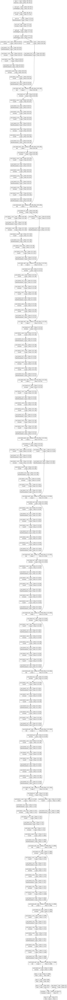

In [ ]:
model_1 = model_1('resnet50')
model_1.summary()
plot_model(model_1,show_shapes=True, show_layer_names=True)

**Model Training**

Initial learning rate: 0.0001
Epoch :  1


Training loss for step 20: 1.0628: 100%|██████████ | 21/21


Train loss :   1.3384, Validation loss :   0.7841, Train Accuracy :  0.474, Test Accuracy :  0.750



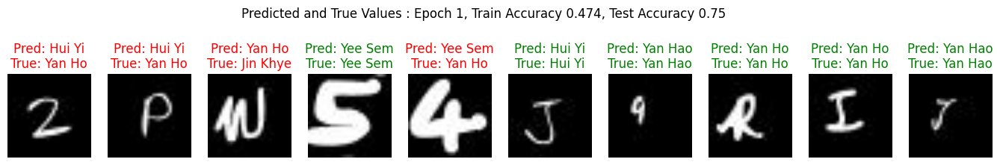



Adjusted learning rate to: 0.00044047619047619046
Epoch :  2


Training loss for step 20: 0.3034: 100%|██████████ | 21/21


Train loss :   0.5586, Validation loss :   0.3832, Train Accuracy :  0.643, Test Accuracy :  0.833



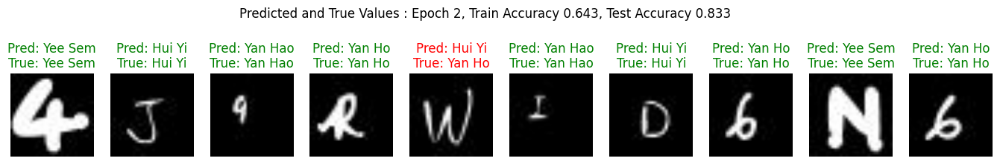



Adjusted learning rate to: 0.0003886363787337945
Epoch :  3


Training loss for step 20: 0.1513: 100%|██████████ | 21/21


Train loss :   0.3399, Validation loss :   0.2580, Train Accuracy :  0.722, Test Accuracy :  0.856



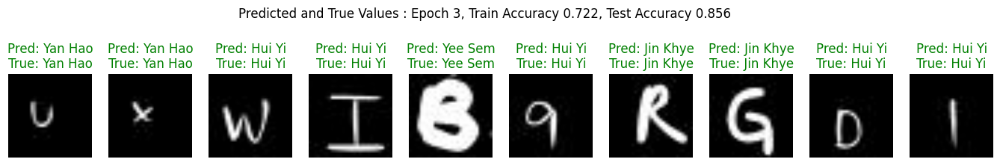



Adjusted learning rate to: 0.00036999144866571847
Epoch :  4


Training loss for step 20: 0.1573: 100%|██████████ | 21/21


Train loss :   0.2308, Validation loss :   0.2489, Train Accuracy :  0.772, Test Accuracy :  0.878



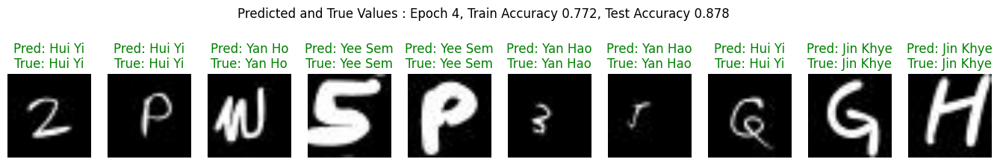



Adjusted learning rate to: 0.0003499447172927768
Epoch :  5


Training loss for step 20: 0.1562: 100%|██████████ | 21/21


Train loss :   0.1976, Validation loss :   0.2154, Train Accuracy :  0.804, Test Accuracy :  0.892



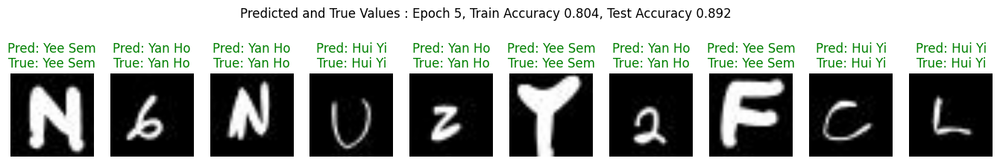



Adjusted learning rate to: 0.000336545398701206
Epoch :  6


Training loss for step 20: 0.0438: 100%|██████████ | 21/21


Train loss :   0.1475, Validation loss :   0.1883, Train Accuracy :  0.829, Test Accuracy :  0.898



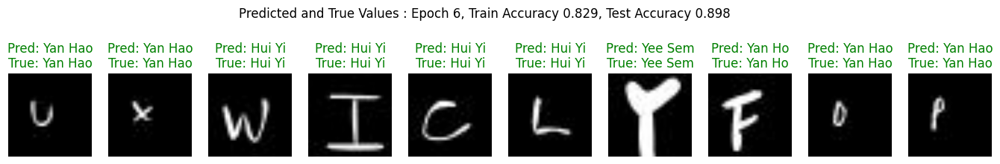



Adjusted learning rate to: 0.0003295178380605946
Epoch :  7


Training loss for step 20: 0.0386: 100%|██████████ | 21/21


Train loss :   0.1136, Validation loss :   0.1797, Train Accuracy :  0.849, Test Accuracy :  0.901



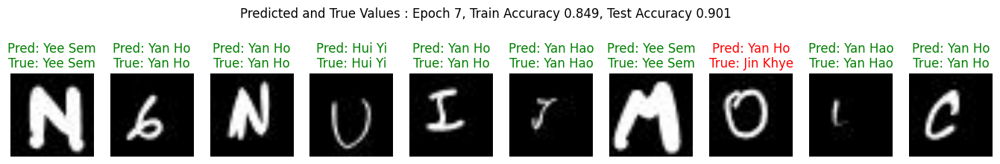



Adjusted learning rate to: 0.00032659118170267297
Epoch :  8


Training loss for step 20: 0.0158: 100%|██████████ | 21/21


Train loss :   0.0958, Validation loss :   0.1708, Train Accuracy :  0.864, Test Accuracy :  0.905



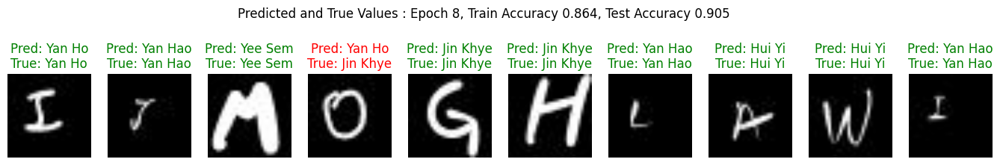



Adjusted learning rate to: 0.00032250540690129185
Epoch :  9


Training loss for step 20: 0.0311: 100%|██████████ | 21/21


Train loss :   0.2160, Validation loss :   0.2423, Train Accuracy :  0.868, Test Accuracy :  0.904



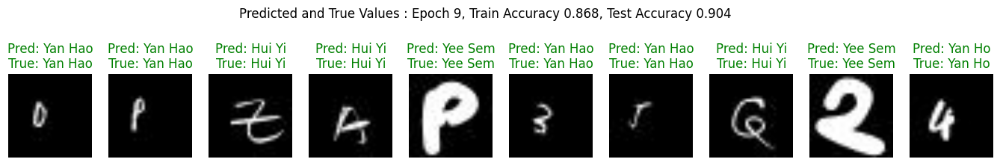



Adjusted learning rate to: 0.000322719531912039
Epoch :  10


Training loss for step 20: 0.0654: 100%|██████████ | 21/21


Train loss :   0.1470, Validation loss :   0.1872, Train Accuracy :  0.876, Test Accuracy :  0.906



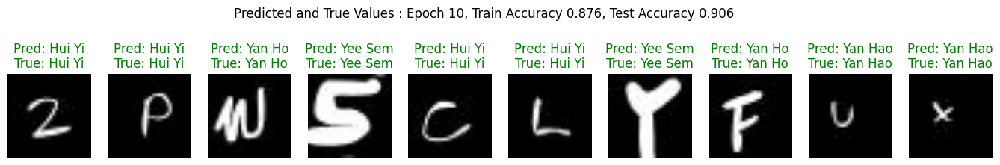



Adjusted learning rate to: 0.0003213446099248465
Epoch :  11


Training loss for step 20: 0.0183: 100%|██████████ | 21/21


Train loss :   0.0800, Validation loss :   0.2338, Train Accuracy :  0.885, Test Accuracy :  0.907



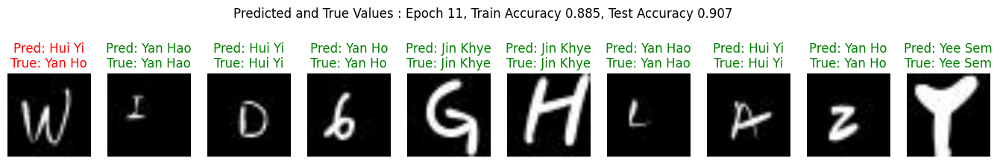



Adjusted learning rate to: 0.0003202117678295244
Epoch :  12


Training loss for step 20: 0.0073: 100%|██████████ | 21/21


Train loss :   0.0700, Validation loss :   0.1658, Train Accuracy :  0.893, Test Accuracy :  0.911



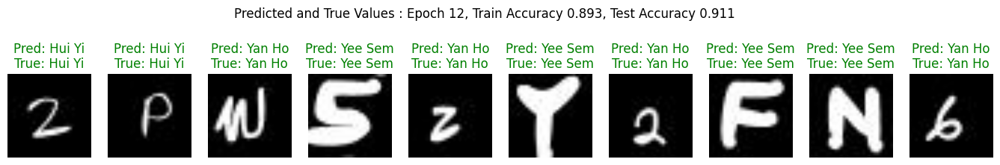



Adjusted learning rate to: 0.00031529201047364284
Epoch :  13


Training loss for step 20: 0.0262: 100%|██████████ | 21/21


Train loss :   0.0441, Validation loss :   0.1678, Train Accuracy :  0.901, Test Accuracy :  0.913



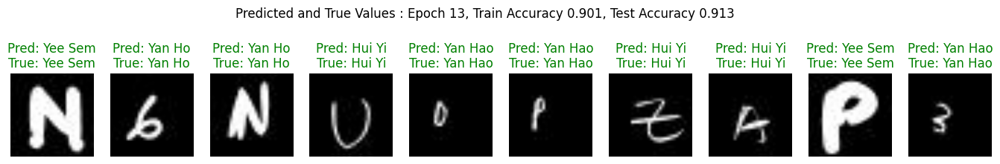



Adjusted learning rate to: 0.00031228204478831964
Epoch :  14


Training loss for step 20: 0.0235: 100%|██████████ | 21/21


Train loss :   0.0481, Validation loss :   0.1448, Train Accuracy :  0.907, Test Accuracy :  0.917



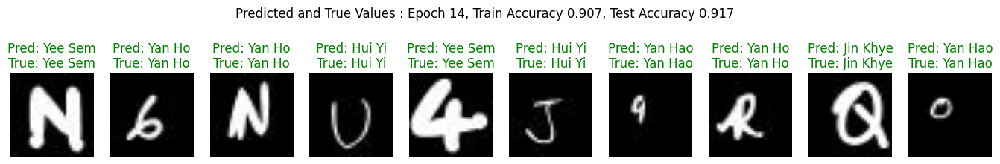



Adjusted learning rate to: 0.00030847455241905325
Epoch :  15


Training loss for step 20: 0.0998: 100%|██████████ | 21/21


Train loss :   0.0471, Validation loss :   0.1519, Train Accuracy :  0.913, Test Accuracy :  0.919



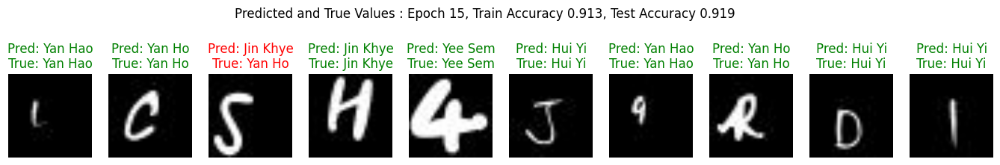



Adjusted learning rate to: 0.0003051087658577283
Epoch :  16


Training loss for step 20: 0.0355: 100%|██████████ | 21/21


Train loss :   0.0997, Validation loss :   0.1347, Train Accuracy :  0.916, Test Accuracy :  0.922



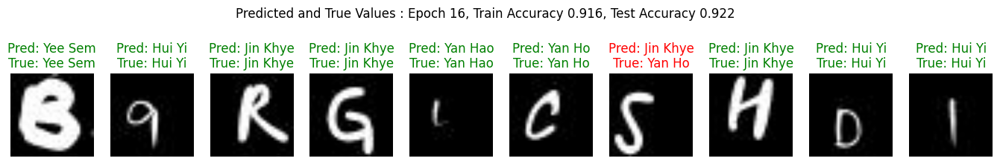



Adjusted learning rate to: 0.0003021116138763197
Epoch :  17


Training loss for step 20: 0.1029: 100%|██████████ | 21/21


Train loss :   0.0346, Validation loss :   0.2762, Train Accuracy :  0.921, Test Accuracy :  0.920



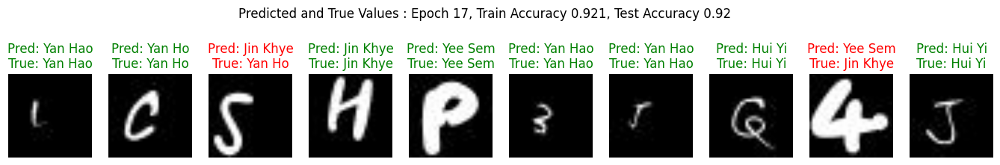



Adjusted learning rate to: 0.0003045082737436366
Epoch :  18


Training loss for step 20: 0.0128: 100%|██████████ | 21/21


Train loss :   0.0367, Validation loss :   0.2196, Train Accuracy :  0.924, Test Accuracy :  0.921



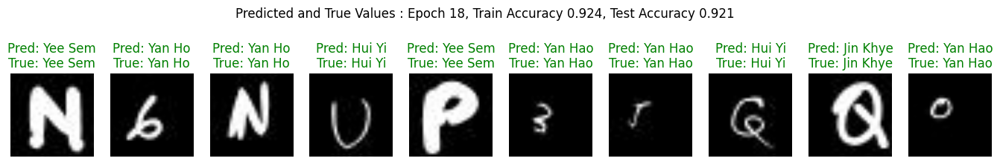



Adjusted learning rate to: 0.00030282971191446353
Epoch :  19


Training loss for step 20: 0.0319: 100%|██████████ | 21/21


Train loss :   0.0314, Validation loss :   0.1697, Train Accuracy :  0.928, Test Accuracy :  0.922



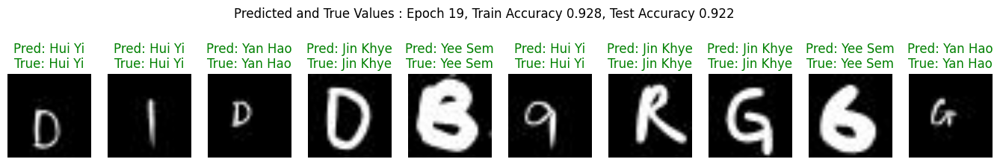



Adjusted learning rate to: 0.0003022251863578209
Epoch :  20


Training loss for step 20: 0.0079: 100%|██████████ | 21/21


Train loss :   0.0244, Validation loss :   0.1300, Train Accuracy :  0.931, Test Accuracy :  0.923



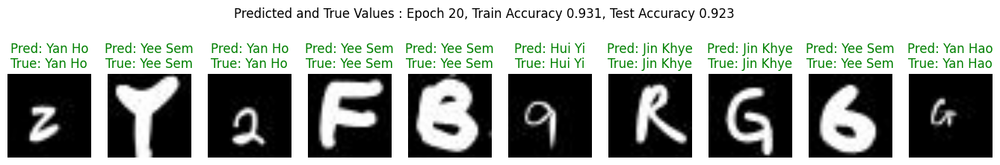



Adjusted learning rate to: 0.00030081186968467606
Epoch :  21


Training loss for step 20: 0.0008: 100%|██████████ | 21/21


Train loss :   0.0392, Validation loss :   0.1783, Train Accuracy :  0.934, Test Accuracy :  0.923



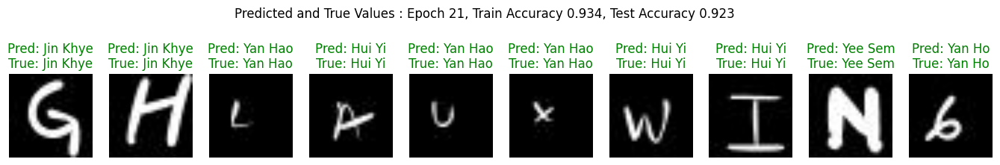



Adjusted learning rate to: 0.00030035577671208905
Epoch :  22


Training loss for step 20: 0.4893: 100%|██████████ | 21/21


Train loss :   0.1132, Validation loss :   0.2090, Train Accuracy :  0.935, Test Accuracy :  0.924



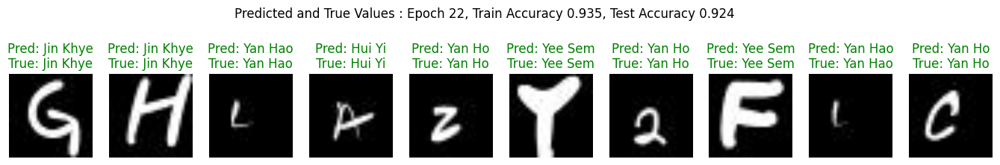



Adjusted learning rate to: 0.00029994016750959057
Epoch :  23


Training loss for step 20: 0.1010: 100%|██████████ | 21/21


Train loss :   0.1952, Validation loss :   0.3362, Train Accuracy :  0.935, Test Accuracy :  0.921



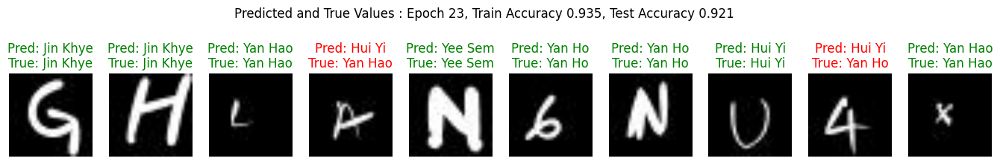



Adjusted learning rate to: 0.0003025802632358035
Epoch :  24


Training loss for step 20: 0.0274: 100%|██████████ | 21/21


Train loss :   0.1108, Validation loss :   0.3151, Train Accuracy :  0.936, Test Accuracy :  0.921



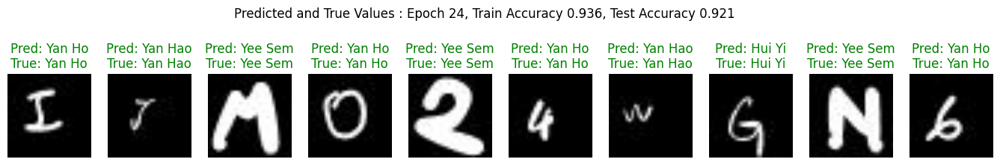



Adjusted learning rate to: 0.00030354498615429873
Epoch :  25


Training loss for step 20: 0.1410: 100%|██████████ | 21/21


Train loss :   0.0717, Validation loss :   0.1181, Train Accuracy :  0.938, Test Accuracy :  0.922



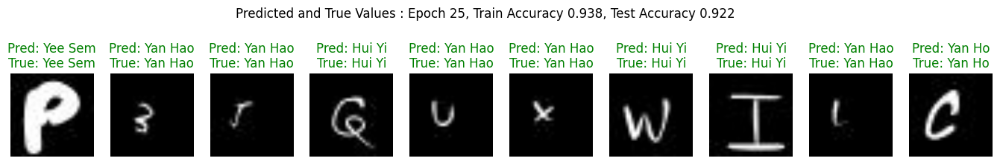



Adjusted learning rate to: 0.0003016794206775074
Epoch :  26


Training loss for step 20: 0.0082: 100%|██████████ | 21/21


Train loss :   0.0245, Validation loss :   0.1852, Train Accuracy :  0.940, Test Accuracy :  0.922



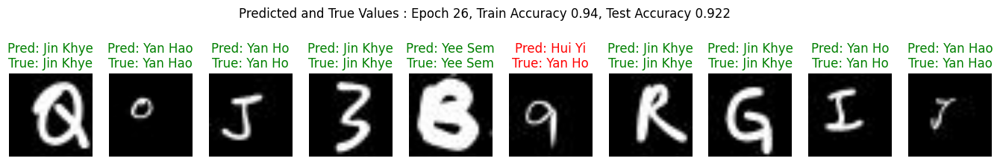



Adjusted learning rate to: 0.0003019454614985261
Epoch :  27


Training loss for step 20: 0.0181: 100%|██████████ | 21/21


Train loss :   0.0196, Validation loss :   0.1127, Train Accuracy :  0.942, Test Accuracy :  0.923



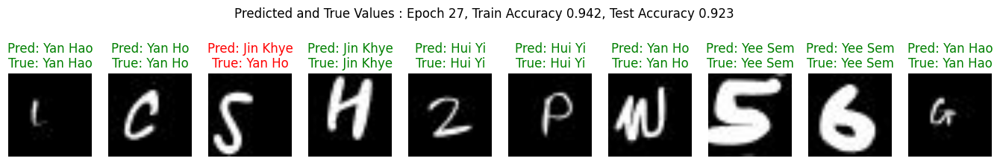



Adjusted learning rate to: 0.0003002634926572689
Epoch :  28


Training loss for step 20: 0.0016: 100%|██████████ | 21/21


Train loss :   0.0156, Validation loss :   0.0981, Train Accuracy :  0.944, Test Accuracy :  0.925



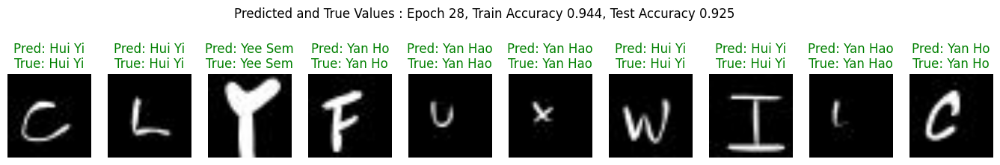



Adjusted learning rate to: 0.00029805811573658375
Epoch :  29


Training loss for step 20: 0.0191: 100%|██████████ | 21/21


Train loss :   0.0130, Validation loss :   0.1041, Train Accuracy :  0.946, Test Accuracy :  0.926



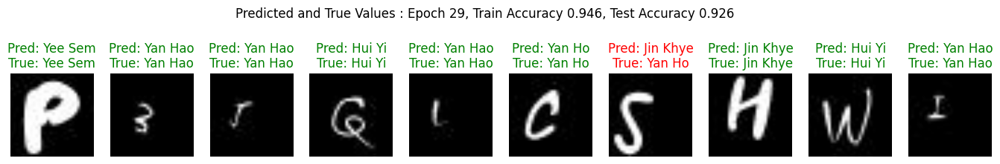



Adjusted learning rate to: 0.00029659535515192824
Epoch :  30


Training loss for step 20: 0.0065: 100%|██████████ | 21/21


Train loss :   0.0137, Validation loss :   0.2094, Train Accuracy :  0.948, Test Accuracy :  0.926



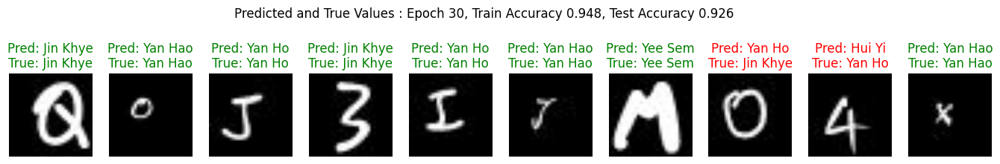

In [ ]:
history = train_model('resnet50',model_1,train_dataset,test_dataset,epochs = 30)

**Result Visualizations**

Loss and Accuracy

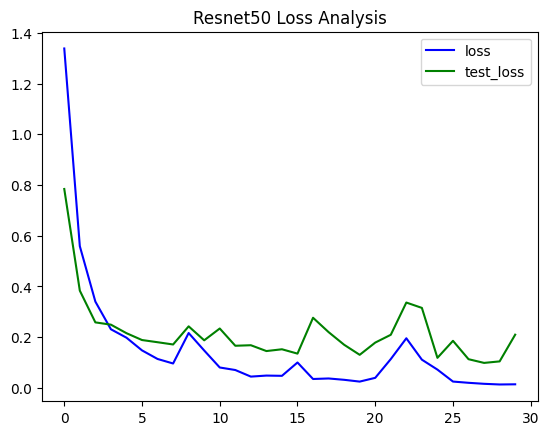

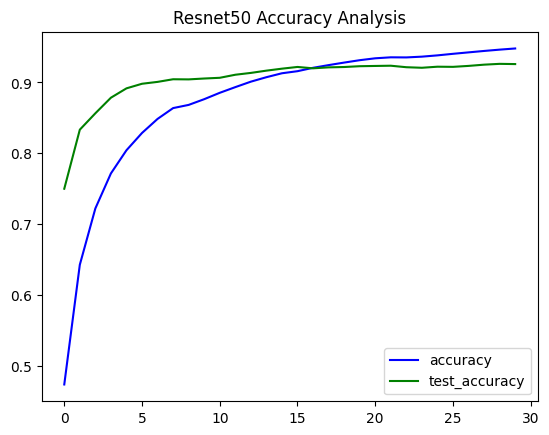

In [ ]:
plot_metrics(history,'loss','Resnet50 Loss Analysis')
print()
plot_metrics(history,'accuracy','Resnet50 Accuracy Analysis')

Predictions

1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 45ms/step


1/1 [==============================] - 0s 34ms/step


1/1 [==============================] - 0s 34ms/step


1/1 [==============================] - 0s 36ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 40ms/step


1/1 [==============================] - 0s 35ms/step


1/1 [==============================] - 0s 38ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 23ms/step


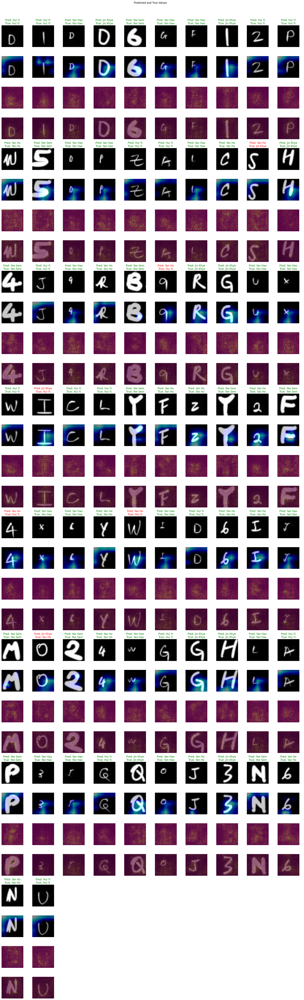

In [ ]:
images_to_plot, features_concat, y_pred_labels,y_true_labels = get_image_ypred_ytrue(model_1,test_dataset)
fault_prediction_images = []
resnet_num_count,resnet_true_count,true_label,pred_label = display_images_with_cam(model_1,images_to_plot, features_concat,y_pred_labels, y_true_labels, "Predicted and True Values","conv5_block3_3_conv")

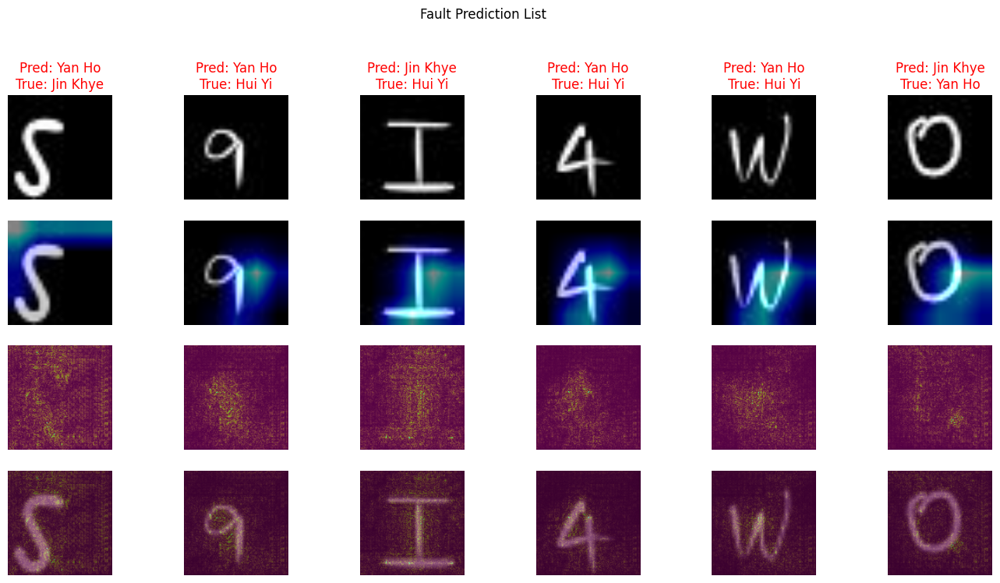

In [ ]:
if len(fault_prediction_images) > 0:
  display_images_fault_prediction_images(fault_prediction_images)
  fault_prediction_images = []
else:
  print("None prediction error")

**Classification Report**

Onwer Accuracy Report

Training Accuracy :  0.9479424
Testing Accuracy  :  0.9259259

Training Loss     :  0.013688763
Training Loss     :  0.20940778

Yee Sem  Accuracy  :  1.0
Hui Yi   Accuracy  :  0.789
Yan Hao  Accuracy  :  1.0
Jin Khye Accuracy  :  0.9
Yan Ho   Accuracy  :  0.929

              precision    recall  f1-score   support

      Hui Yi       1.00      0.79      0.88        19
    Jin Khye       0.82      0.90      0.86        10
     Yan Hao       1.00      1.00      1.00        18
      Yan Ho       0.76      0.93      0.84        14
     Yee Sem       1.00      1.00      1.00        11

    accuracy                           0.92        72
   macro avg       0.92      0.92      0.92        72
weighted avg       0.93      0.92      0.92        72




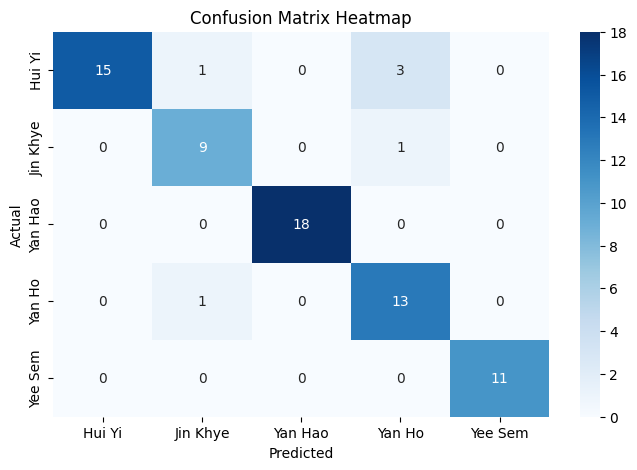

In [ ]:
print("Training Accuracy : ",history['accuracy'][-1].numpy())
print("Testing Accuracy  : ",history['test_accuracy'][-1].numpy())
print()
print("Training Loss     : ",history['loss'][-1])
print("Training Loss     : ",history['test_loss'][-1])
print()
print("Yee Sem  Accuracy  : ",round(resnet_true_count['Yee Sem'] / resnet_num_count['Yee Sem'],3))
print("Hui Yi   Accuracy  : ",round(resnet_true_count['Hui Yi'] / resnet_num_count['Hui Yi'],3))
print("Yan Hao  Accuracy  : ",round(resnet_true_count['Yan Hao'] / resnet_num_count['Yan Hao'],3))
print("Jin Khye Accuracy  : ",round(resnet_true_count['Jin Khye'] / resnet_num_count['Jin Khye'],3))
print("Yan Ho   Accuracy  : ",round(resnet_true_count['Yan Ho'] / resnet_num_count['Yan Ho'],3))

print()
report = classification_report(true_label,pred_label)
print(report)

print()
labels = ['Yee Sem','Hui Yi','Yan Hao','Jin Khye','Yan Ho']
labels.sort(reverse = False)
cm = confusion_matrix(true_label, pred_label,labels = labels)

plt.figure(figsize=(8, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix Heatmap')
plt.show()

Alphanumeric Accuracy Report

Accuracy of 1  :  0.9  Accuracy of 2  :  1.0  Accuracy of 3  :  1.0 
Accuracy of 4  : 0.95  Accuracy of 5  :  1.0  Accuracy of 6  :  1.0 
Accuracy of 7  :  1.0  Accuracy of 8  : 0.95  Accuracy of 9  : 0.95 
Accuracy of 0  :  1.0  Accuracy of A  :  1.0  Accuracy of B  :  1.0 
Accuracy of C  :  1.0  Accuracy of D  :  1.0  Accuracy of E  :  1.0 
Accuracy of F  :  1.0  Accuracy of G  :  1.0  Accuracy of H  :  1.0 
Accuracy of I  : 0.95  Accuracy of J  :  1.0  Accuracy of K  :  1.0 
Accuracy of L  :  1.0  Accuracy of M  :  1.0  Accuracy of N  :  1.0 
Accuracy of O  : 0.95  Accuracy of P  :  1.0  Accuracy of Q  :  1.0 
Accuracy of R  :  1.0  Accuracy of S  : 0.95  Accuracy of T  :  1.0 
Accuracy of U  :  1.0  Accuracy of V  :  1.0  Accuracy of W  : 0.95 
Accuracy of X  :  1.0  Accuracy of Y  :  1.0  Accuracy of Z  :  1.0 



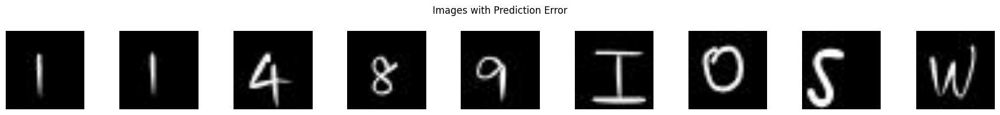

In [ ]:
acc,error_image = calculate_alpha_digit_acc(model_1, dataset)
for i in range(0,len(character),3):
  print(f"Accuracy of {character[i] : <2} : {acc[i] :4} "
        ,f"Accuracy of {character[i+1] : <2} : {acc[i+1] :4} "
        ,f"Accuracy of {character[i+2] : <2} : {acc[i+2] :4} ")

print()

display_error_images(error_image)

# **Model 2 - InceptionV3**

**Model Architecture**

In [ ]:
type_ = 'inceptionv3'
inceptionv3_model = model_1('inceptionv3')
inceptionv3_model.summary()
plot_model(inceptionv3_model,show_shapes=True, show_layer_names=True)

Model: "model_74"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 150, 150, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 74, 74, 32)           864       ['input_3[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 74, 74, 32)           96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 74, 74, 32)           0         ['batch_normalization[0

  0%|           | 0/21


**Model Training**

Initial learning rate: 0.0001
Epoch :  1


Training loss for step 20: 0.0833: 100%|██████████ | 21/21


Train loss :   0.9400, Validation loss :   0.4127, Train Accuracy :  0.940, Test Accuracy :  0.923



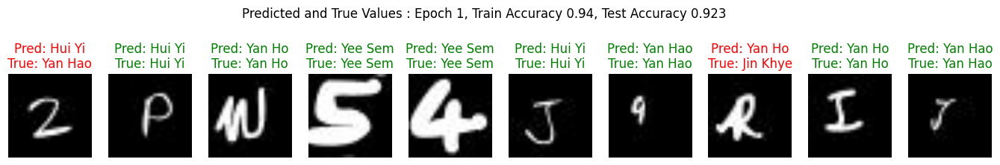



Adjusted learning rate to: 0.00030022178858808105
Epoch :  2


Training loss for step 20: 0.0018: 100%|██████████ | 21/21


Train loss :   0.0717, Validation loss :   0.1471, Train Accuracy :  0.942, Test Accuracy :  0.924



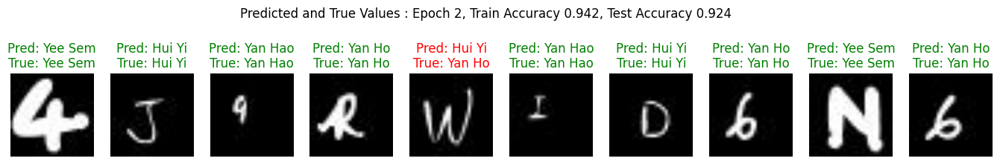



Adjusted learning rate to: 0.00029994016750959057
Epoch :  3


Training loss for step 20: 0.0105: 100%|██████████ | 21/21


Train loss :   0.0105, Validation loss :   0.2743, Train Accuracy :  0.943, Test Accuracy :  0.924



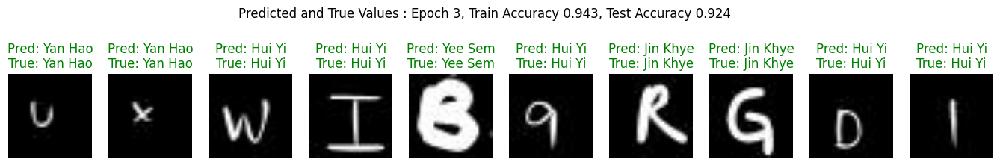



Adjusted learning rate to: 0.0002991440639078227
Epoch :  4


Training loss for step 20: 0.0013: 100%|██████████ | 21/21


Train loss :   0.0133, Validation loss :   0.1584, Train Accuracy :  0.945, Test Accuracy :  0.924



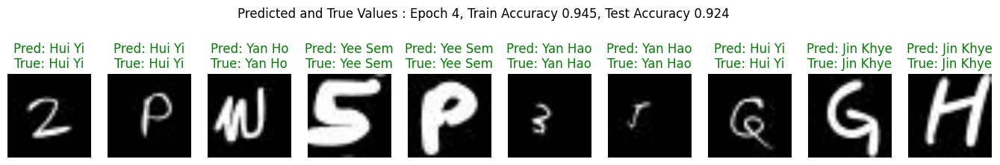



Adjusted learning rate to: 0.00029890927514649145
Epoch :  5


Training loss for step 20: 0.0001: 100%|██████████ | 21/21


Train loss :   0.0009, Validation loss :   0.1050, Train Accuracy :  0.946, Test Accuracy :  0.926



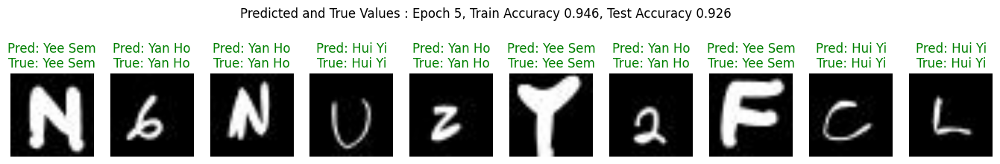



Adjusted learning rate to: 0.0002971731244465752
Epoch :  6


Training loss for step 20: 0.0011: 100%|██████████ | 21/21


Train loss :   0.0004, Validation loss :   0.0897, Train Accuracy :  0.948, Test Accuracy :  0.927



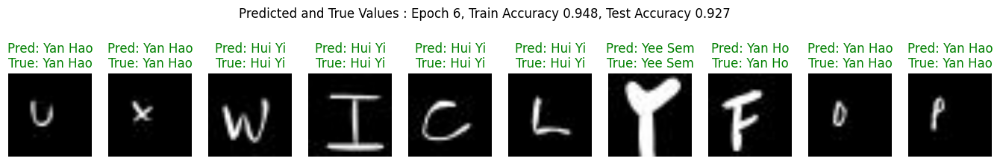



Adjusted learning rate to: 0.00029551815680817044
Epoch :  7


Training loss for step 20: 0.0003: 100%|██████████ | 21/21


Train loss :   0.0002, Validation loss :   0.0863, Train Accuracy :  0.949, Test Accuracy :  0.928



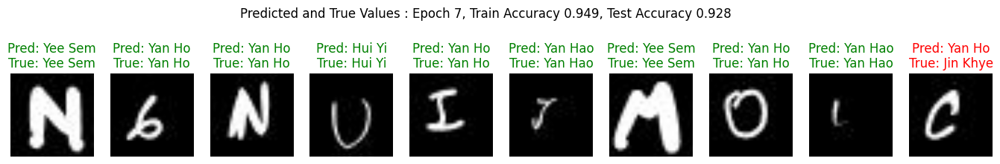



Adjusted learning rate to: 0.0002944261551305071
Epoch :  8


Training loss for step 20: 0.0006: 100%|██████████ | 21/21


Train loss :   0.0002, Validation loss :   0.0869, Train Accuracy :  0.951, Test Accuracy :  0.929



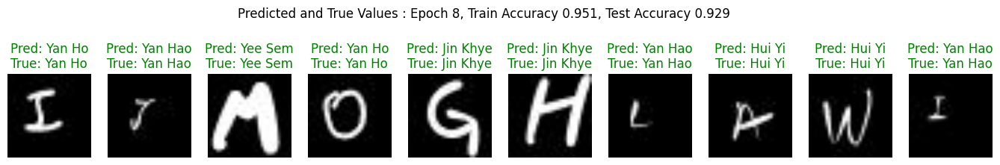



Adjusted learning rate to: 0.00029290831420811345
Epoch :  9


Training loss for step 20: 0.0001: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0860, Train Accuracy :  0.952, Test Accuracy :  0.930



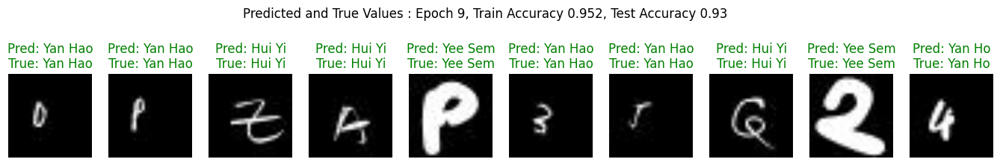



Adjusted learning rate to: 0.0002914565396741096
Epoch :  10


Training loss for step 20: 0.0003: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0846, Train Accuracy :  0.953, Test Accuracy :  0.931



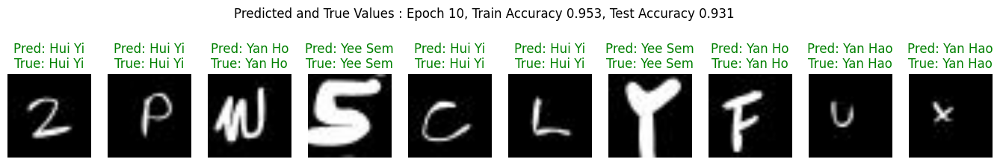



Adjusted learning rate to: 0.0002900667477468714
Epoch :  11


Training loss for step 20: 0.0000: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0834, Train Accuracy :  0.954, Test Accuracy :  0.932



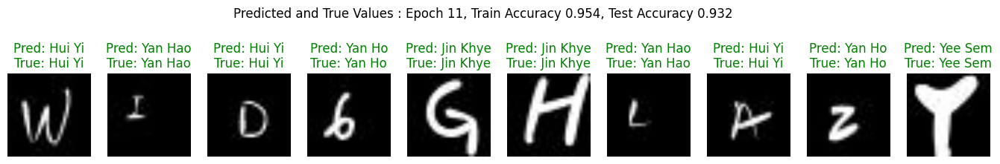



Adjusted learning rate to: 0.0002887348744054976
Epoch :  12


Training loss for step 20: 0.0000: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0820, Train Accuracy :  0.955, Test Accuracy :  0.933



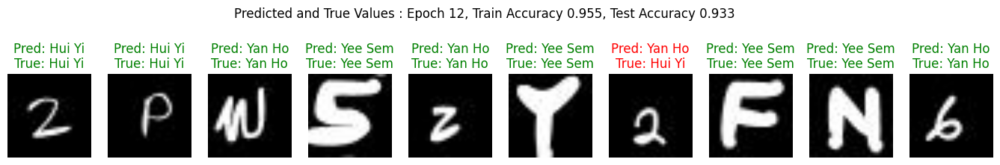



Adjusted learning rate to: 0.0002874573770675194
Epoch :  13


Training loss for step 20: 0.0002: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0808, Train Accuracy :  0.956, Test Accuracy :  0.934



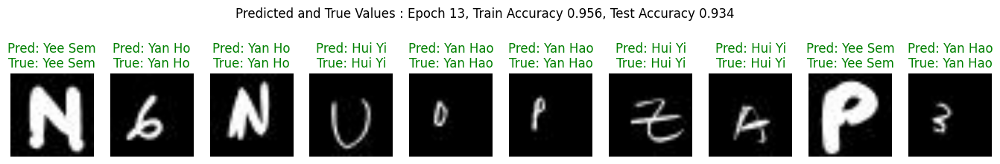



Adjusted learning rate to: 0.00028623102710547755
Epoch :  14


Training loss for step 20: 0.0001: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0799, Train Accuracy :  0.957, Test Accuracy :  0.935



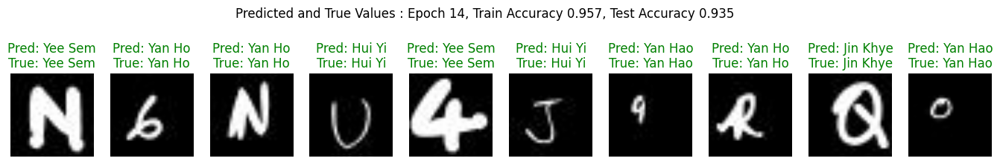



Adjusted learning rate to: 0.0002850528529817126
Epoch :  15


Training loss for step 20: 0.0001: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0790, Train Accuracy :  0.958, Test Accuracy :  0.936



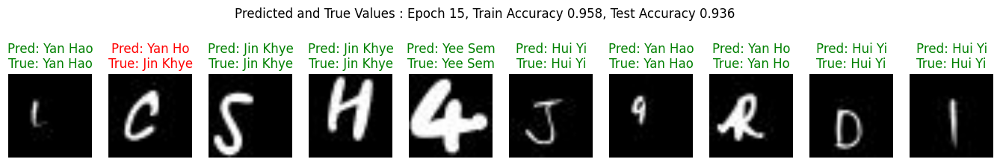



Adjusted learning rate to: 0.0002839199149560116
Epoch :  16


Training loss for step 20: 0.0000: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0783, Train Accuracy :  0.959, Test Accuracy :  0.937



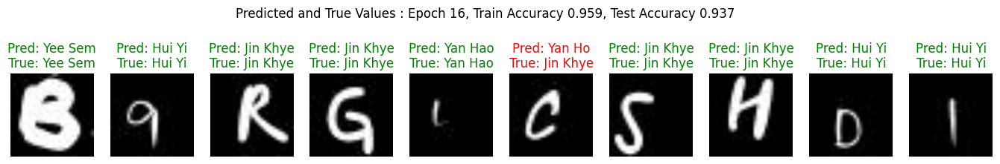



Adjusted learning rate to: 0.0002828297282130447
Epoch :  17


Training loss for step 20: 0.0002: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0777, Train Accuracy :  0.960, Test Accuracy :  0.937



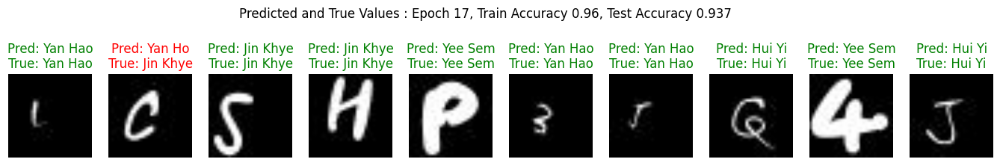



Adjusted learning rate to: 0.00028177987154802213
Epoch :  18


Training loss for step 20: 0.0000: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0778, Train Accuracy :  0.961, Test Accuracy :  0.938



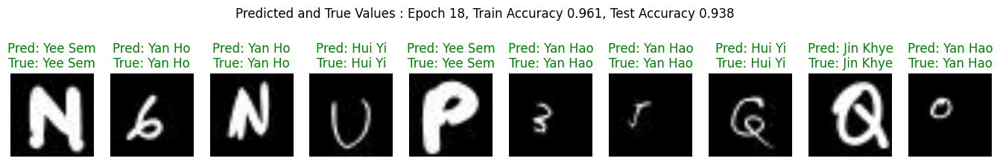



Adjusted learning rate to: 0.0002803636176629957
Epoch :  19


Training loss for step 20: 0.0001: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0776, Train Accuracy :  0.962, Test Accuracy :  0.939



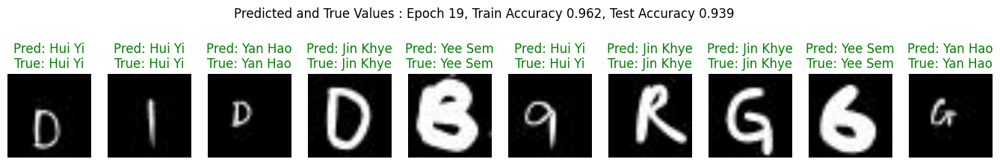



Adjusted learning rate to: 0.00027899507343781267
Epoch :  20


Training loss for step 20: 0.0001: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0767, Train Accuracy :  0.962, Test Accuracy :  0.940



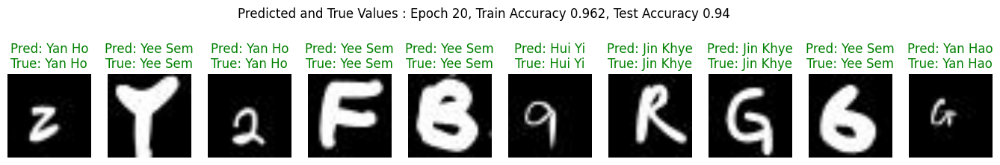



Adjusted learning rate to: 0.00027767167077681084
Epoch :  21


Training loss for step 20: 0.0000: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0769, Train Accuracy :  0.963, Test Accuracy :  0.941



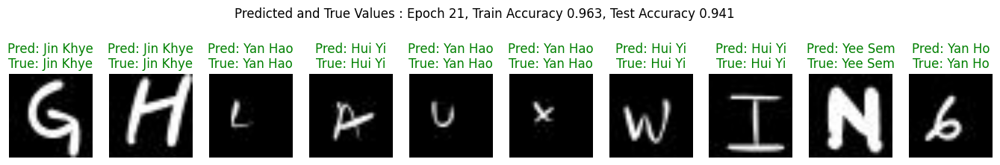



Adjusted learning rate to: 0.00027639122601612673
Epoch :  22


Training loss for step 20: 0.0000: 100%|██████████ | 21/21


Train loss :   0.0001, Validation loss :   0.0771, Train Accuracy :  0.964, Test Accuracy :  0.942



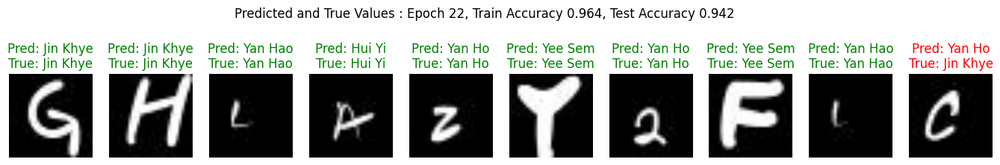



Adjusted learning rate to: 0.0002751517047040319
Epoch :  23


Training loss for step 20: 0.0000: 100%|██████████ | 21/21


Train loss :   0.0000, Validation loss :   0.0768, Train Accuracy :  0.965, Test Accuracy :  0.943



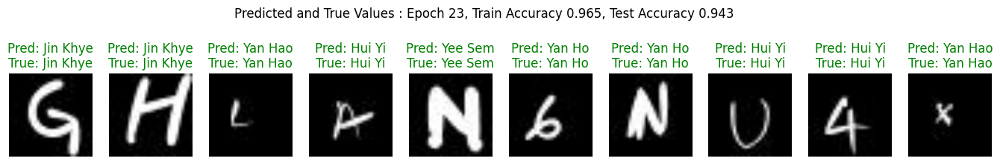



Adjusted learning rate to: 0.0002739512340443144
Epoch :  24


Training loss for step 20: 0.0000: 100%|██████████ | 21/21


Train loss :   0.0000, Validation loss :   0.0760, Train Accuracy :  0.965, Test Accuracy :  0.944



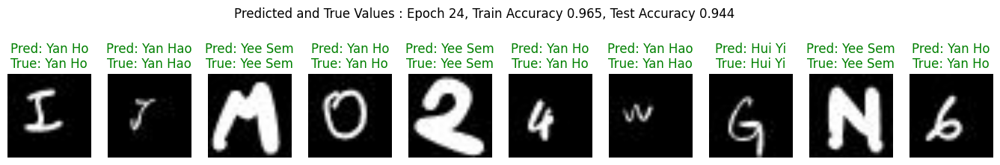



Adjusted learning rate to: 0.00027278785406641587
Epoch :  25


Training loss for step 20: 0.0000: 100%|██████████ | 21/21


Train loss :   0.0000, Validation loss :   0.0744, Train Accuracy :  0.966, Test Accuracy :  0.944



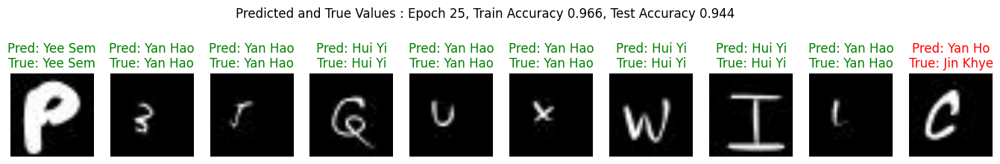



Adjusted learning rate to: 0.00027165995786919986
Epoch :  26


Training loss for step 20: 0.0001: 100%|██████████ | 21/21


Train loss :   0.0000, Validation loss :   0.0706, Train Accuracy :  0.966, Test Accuracy :  0.945



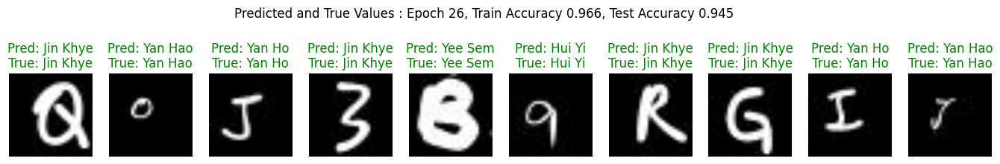



Adjusted learning rate to: 0.0002705658681259883
Epoch :  27


Training loss for step 20: 0.0000: 100%|██████████ | 21/21


Train loss :   0.0000, Validation loss :   0.0679, Train Accuracy :  0.967, Test Accuracy :  0.946



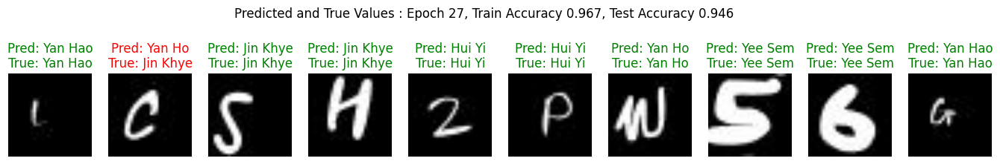



Adjusted learning rate to: 0.0002695040164643214
Epoch :  28


Training loss for step 20: 0.0000: 100%|██████████ | 21/21


Train loss :   0.0000, Validation loss :   0.0653, Train Accuracy :  0.968, Test Accuracy :  0.947



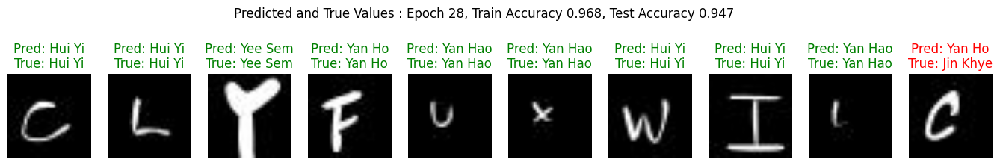



Adjusted learning rate to: 0.0002684732175292106
Epoch :  29


Training loss for step 20: 0.0001: 100%|██████████ | 21/21


Train loss :   0.0000, Validation loss :   0.0639, Train Accuracy :  0.968, Test Accuracy :  0.947



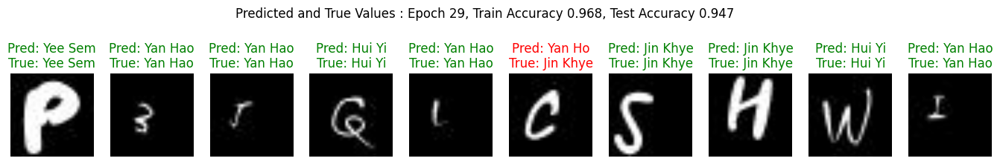



Adjusted learning rate to: 0.0002678245033689044
Epoch :  30


Training loss for step 20: 0.0001: 100%|██████████ | 21/21


Train loss :   0.0000, Validation loss :   0.0600, Train Accuracy :  0.969, Test Accuracy :  0.947



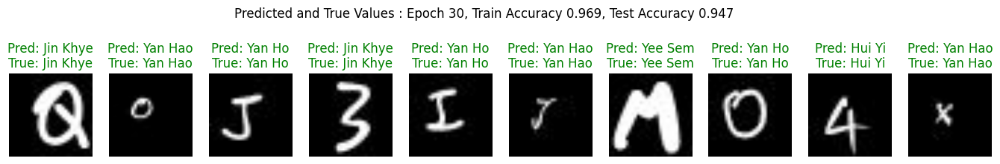

In [ ]:
history = train_model(type_,inceptionv3_model,train_dataset,test_dataset,epochs = 30)

**Result Visualizations**

Loss and Accuracy

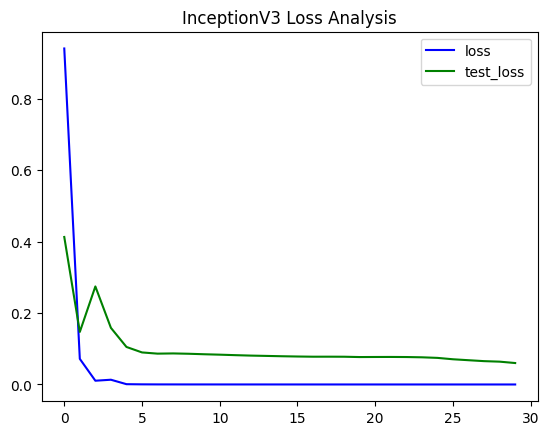

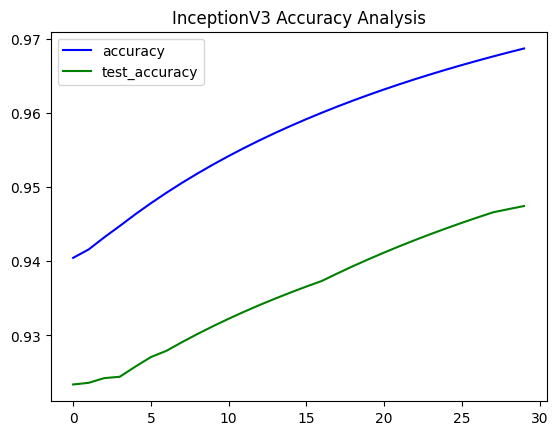

In [ ]:
plot_metrics(history,'loss','InceptionV3 Loss Analysis')
print()
plot_metrics(history,'accuracy','InceptionV3 Accuracy Analysis')

Predictions

1/1 [==============================] - 3s 3s/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 40ms/step


1/1 [==============================] - 0s 67ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 40ms/step


1/1 [==============================] - 0s 43ms/step


1/1 [==============================] - 0s 35ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 35ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 42ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 40ms/step


1/1 [==============================] - 0s 52ms/step


1/1 [==============================] - 0s 41ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 25ms/step


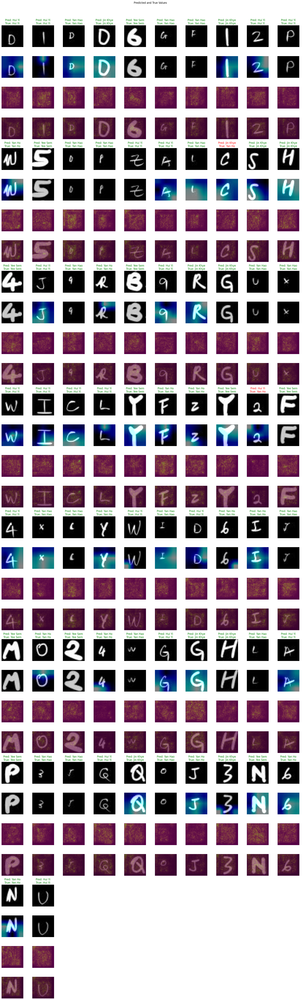

In [ ]:
images_to_plot, features_concat, y_pred_labels,y_true_labels = get_image_ypred_ytrue(inceptionv3_model,test_dataset)
fault_prediction_images = []
inception_num_count,inception_true_count,true_label,pred_label = display_images_with_cam(inceptionv3_model,images_to_plot, features_concat,y_pred_labels, y_true_labels, "Predicted and True Values","mixed10")

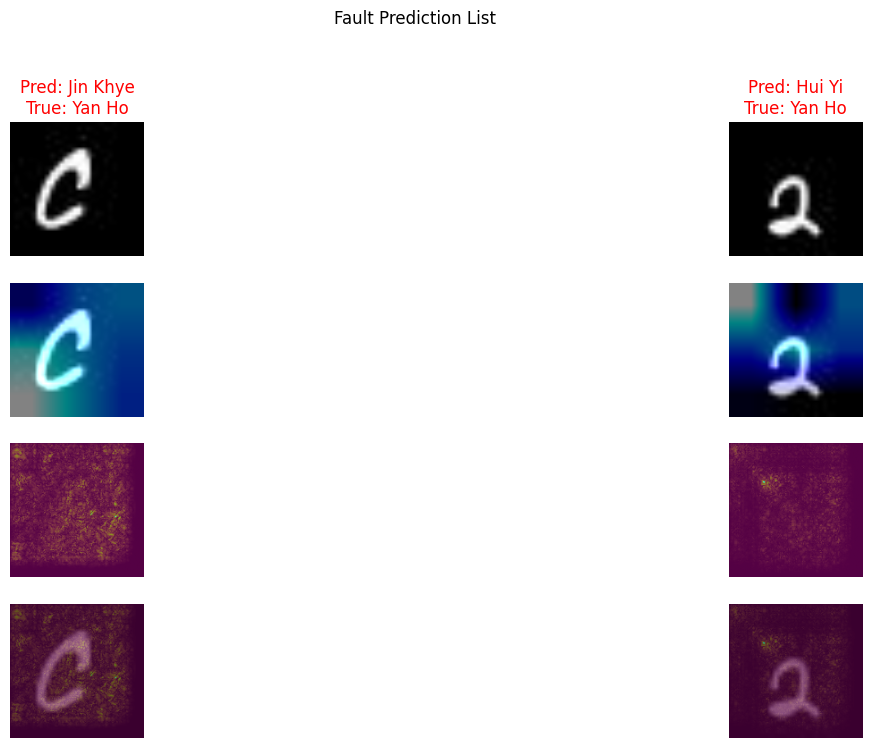

In [ ]:
if len(fault_prediction_images) > 0:
  display_images_fault_prediction_images(fault_prediction_images)
  fault_prediction_images = []
else:
  print("None prediction error")

**Classification Report**

Owner Accuracy Report

Training Accuracy :  0.96869856
Testing Accuracy  :  0.9474537

Training Loss     :  2.8932054e-05
Training Loss     :  0.060012758

Yee Sem  Accuracy  :  1.0
Hui Yi   Accuracy  :  1.0
Yan Hao  Accuracy  :  1.0
Jin Khye Accuracy  :  1.0
Yan Ho   Accuracy  :  0.857

              precision    recall  f1-score   support

      Hui Yi       0.95      1.00      0.97        19
    Jin Khye       0.91      1.00      0.95        10
     Yan Hao       1.00      1.00      1.00        18
      Yan Ho       1.00      0.86      0.92        14
     Yee Sem       1.00      1.00      1.00        11

    accuracy                           0.97        72
   macro avg       0.97      0.97      0.97        72
weighted avg       0.97      0.97      0.97        72




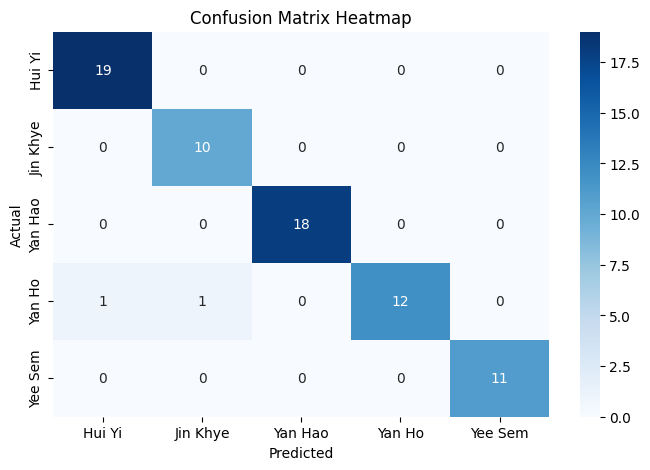

In [ ]:
print("Training Accuracy : ",history['accuracy'][-1].numpy())
print("Testing Accuracy  : ",history['test_accuracy'][-1].numpy())
print()
print("Training Loss     : ",history['loss'][-1])
print("Training Loss     : ",history['test_loss'][-1])
print()
print("Yee Sem  Accuracy  : ",round(inception_true_count['Yee Sem'] / inception_num_count['Yee Sem'],3))
print("Hui Yi   Accuracy  : ",round(inception_true_count['Hui Yi'] / inception_num_count['Hui Yi'],3))
print("Yan Hao  Accuracy  : ",round(inception_true_count['Yan Hao'] / inception_num_count['Yan Hao'],3))
print("Jin Khye Accuracy  : ",round(inception_true_count['Jin Khye'] / inception_num_count['Jin Khye'],3))
print("Yan Ho   Accuracy  : ",round(inception_true_count['Yan Ho'] / inception_num_count['Yan Ho'],3))

print()
report = classification_report(true_label,pred_label)
print(report)

print()
labels = ['Yee Sem','Hui Yi','Yan Hao','Jin Khye','Yan Ho']
labels.sort(reverse=False)
cm = confusion_matrix(true_label, pred_label,labels = labels)

plt.figure(figsize=(8, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix Heatmap')
plt.show()

Alphanumeric Accuracy Report

Accuracy of 1  :  1.0  Accuracy of 2  : 0.95  Accuracy of 3  :  1.0 
Accuracy of 4  :  1.0  Accuracy of 5  :  1.0  Accuracy of 6  :  1.0 
Accuracy of 7  :  1.0  Accuracy of 8  :  1.0  Accuracy of 9  :  1.0 
Accuracy of 0  :  1.0  Accuracy of A  :  1.0  Accuracy of B  :  1.0 
Accuracy of C  : 0.95  Accuracy of D  :  1.0  Accuracy of E  :  1.0 
Accuracy of F  :  1.0  Accuracy of G  :  1.0  Accuracy of H  :  1.0 
Accuracy of I  :  1.0  Accuracy of J  :  1.0  Accuracy of K  :  1.0 
Accuracy of L  :  1.0  Accuracy of M  :  1.0  Accuracy of N  :  1.0 
Accuracy of O  :  1.0  Accuracy of P  :  1.0  Accuracy of Q  :  1.0 
Accuracy of R  :  1.0  Accuracy of S  :  1.0  Accuracy of T  :  1.0 
Accuracy of U  :  1.0  Accuracy of V  :  1.0  Accuracy of W  :  1.0 
Accuracy of X  :  1.0  Accuracy of Y  :  1.0  Accuracy of Z  :  1.0 



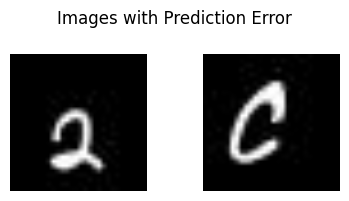

In [ ]:
acc,error_image = calculate_alpha_digit_acc(inceptionv3_model, dataset)
for i in range(0,len(character),3):
  print(f"Accuracy of {character[i] : <2} : {acc[i] :4} "
        ,f"Accuracy of {character[i+1] : <2} : {acc[i+1] :4} "
        ,f"Accuracy of {character[i+2] : <2} : {acc[i+2] :4} ")

print()

display_error_images(error_image)